# Libreries

In [103]:
import os
import random
import shutil
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2

import torch
import torch.nn as nn
from torch.optim import SGD, AdamW
from torch.utils.data import DataLoader, Dataset, random_split, ConcatDataset
from pytorch_lightning.callbacks import EarlyStopping
import torchvision
from torchsummary import summary

from torchvision import transforms
from torchvision.utils import make_grid

import pytorch_lightning as pl

from skimage.metrics import peak_signal_noise_ratio as psnr, structural_similarity as ssim

import warnings

# Disabilita tutti i warning
warnings.filterwarnings("ignore")

device = "cuda" if torch.cuda.is_available() else "cpu"

In [182]:
def show_image(image, size=(3,3)):
    if isinstance(image, str):
        image = mpimg.imread(image)
        
    plt.figure(figsize=size)  # Imposta le dimensioni della figura
    plt.imshow(image)
    plt.axis('off')  # Rimuove gli assi dall'immagine
    plt.show()

# Dataset preprocessing

## Image Resizing

In [3]:
input_folder = "wild birds shots - Ricerca Google"

In [4]:
# import os

# def delete_non_jpg_images(directory):
#     # Controlla se la directory esiste
#     if not os.path.exists(directory):
#         print(f"La directory {directory} non esiste.")
#         return

#     # Itera attraverso tutti i file nella directory
#     for filename in os.listdir(directory):
#         # Ottieni il percorso completo del file
#         file_path = os.path.join(directory, filename)

#         # Controlla se il file ha un'estensione diversa da .jpg
#         if os.path.isfile(file_path) and not filename.lower().endswith('.jpg'):
#             try:
#                 # Cancella il file
#                 os.remove(file_path)
#                 print(f"Cancellato: {file_path}")
#             except Exception as e:
#                 print(f"Errore durante la cancellazione di {file_path}: {e}")

# delete_non_jpg_images(input_folder)


In [5]:
# output_folder = "dataset"

# # Cancella la cartella di output se esiste
# if os.path.exists(output_folder):
#     shutil.rmtree(output_folder)

# # Crea la cartella di output
# os.makedirs(output_folder)

# image_number = 1
# valid_extensions = ('.jpg', '.jpeg', '.png')

# for file_name in os.listdir(input_folder):
#     input_path = os.path.join(input_folder, file_name)
    
#     if file_name.lower().endswith(valid_extensions):
#         try:
#             image = Image.open(input_path).convert("RGB")
            
#             # Calcola il crop_size specifico per ogni immagine
#             crop_size = min(image.size)
            
#             # Definisci la trasformazione per ogni immagine
#             transform = transforms.Compose([
#                 transforms.CenterCrop(crop_size),  # Taglia per ottenere un'immagine quadrata
#                 transforms.Resize((128, 128)),
#                 transforms.ToTensor()
#             ])
            
#             resized_image = transform(image)
            
#             output_path = os.path.join(output_folder, f"{image_number}.jpg")
            
#             torchvision.utils.save_image(resized_image, output_path)
            
#             image_number += 1
#         except Exception as e:
#             print(f"Errore nell'elaborazione dell'immagine {file_name}: {e}")

# print("Operazione completata. Le immagini sono state ridimensionate e salvate nella cartella di output.")

Operazione completata. Le immagini sono state ridimensionate e salvate nella cartella di output.


## Adding noise

In [132]:
# Livello di rumore
noise_level = 0.03  # Puoi variare questo valore per aumentare o diminuire il rumore

### Chromatic noise

In [153]:
def add_chromatic_noise(image, noise_level=0.1):
    """
    Aggiunge rumore cromatico a un'immagine RGB.

    :param image: Immagine RGB come oggetto PIL.Image.
    :param noise_level: Livello di rumore (0-1), dove 0 è senza rumore e 1 è rumore massimo.
    :return: Immagine con rumore cromatico aggiunto come oggetto PIL.Image.
    """
    
    if type(image) == str:
        image = mpimg.imread(image)
    # Converti l'immagine in un array numpy
    image_array = np.array(image).astype(np.float32) / 255.0

    # Genera rumore cromatico
    noise = np.random.normal(scale=noise_level, size=image_array.shape)

    # Aggiungi il rumore all'immagine
    noisy_image = image_array + noise

    # Clippa i valori per essere nell'intervallo [0, 1]
    noisy_image = np.clip(noisy_image, 0.0, 1.0)

    # Converti di nuovo in formato immagine PIL
    noisy_image = (noisy_image * 255).astype(np.uint8)
    noisy_image = Image.fromarray(noisy_image)

    return noisy_image

# # Percorsi delle cartelle
# input_folder = "dataset"
# output_folder = "dataset_chromatic_noise"

# # Crea la cartella di output se non esiste
# if not os.path.exists(output_folder):
#     os.makedirs(output_folder)

# # Lista dei file nella cartella di input
# file_list = os.listdir(input_folder)

# # Processo per aggiungere rumore cromatico alle immagini
# for file_name in file_list:
#     input_path = os.path.join(input_folder, file_name)
#     image = Image.open(input_path).convert('RGB')
#     noisy_image = add_chromatic_noise(image, noise_level)
#     output_path = os.path.join(output_folder, f"{file_name}")
#     noisy_image.save(output_path)

# print("Operazione completata. Le immagini con rumore aggiunto sono state salvate nella cartella di output.")

### Luminance Noise

In [152]:
def add_luminance_noise(image, noise_level=0.1):
    """
    Aggiunge rumore luminoso a un'immagine RGB.

    :param image: Immagine RGB come oggetto PIL.Image.
    :param noise_level: Livello di rumore (0-1), dove 0 è senza rumore e 1 è rumore massimo.
    :return: Immagine con rumore luminoso aggiunto come oggetto PIL.Image.
    """
    
    if type(image) == str:
        image = mpimg.imread(image)
        
    # Converti l'immagine in un array numpy
    image_array = np.array(image).astype(np.float32) / 255.0

    # Genera rumore luminoso
    noise = np.random.normal(scale=noise_level, size=image_array.shape[:2])
    noise = np.expand_dims(noise, axis=-1)

    # Aggiungi il rumore all'immagine
    noisy_image = image_array + noise

    # Clippa i valori per essere nell'intervallo [0, 1]
    noisy_image = np.clip(noisy_image, 0.0, 1.0)

    # Converti di nuovo in formato immagine PIL
    noisy_image = (noisy_image * 255).astype(np.uint8)
    noisy_image = Image.fromarray(noisy_image)

    return noisy_image

# # Percorsi delle cartelle
# input_folder = "dataset"
# output_folder = "dataset_luminance_noise"

# # Crea la cartella di output se non esiste
# if not os.path.exists(output_folder):
#     os.makedirs(output_folder)

# # Lista dei file nella cartella di input
# file_list = os.listdir(input_folder)

# # Processo per aggiungere rumore luminoso alle immagini
# for file_name in file_list:
#     input_path = os.path.join(input_folder, file_name)
#     image = Image.open(input_path).convert('RGB')
#     noisy_image = add_luminance_noise(image, noise_level)
#     output_path = os.path.join(output_folder, f"{file_name}")
#     noisy_image.save(output_path)

# print("Operazione completata. Le immagini con rumore aggiunto sono state salvate nella cartella di output.")

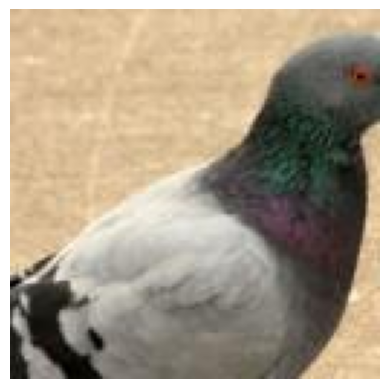

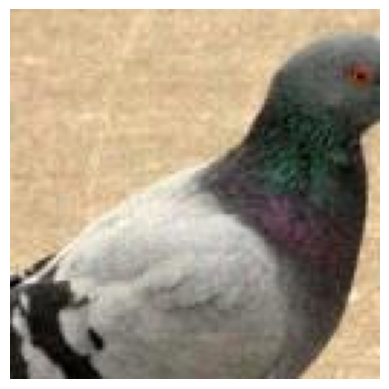

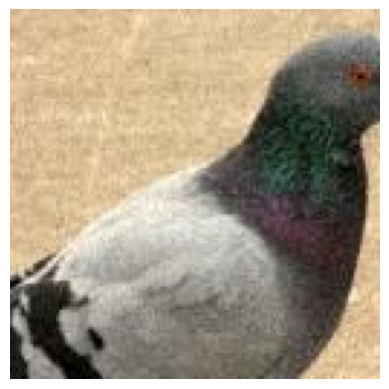

In [9]:
show_image("dataset/4.jpg")
show_image("dataset_chromatic_noise/4.jpg")
show_image("dataset_luminance_noise/4.jpg")

# Utility functions

In [2]:
def calculate_psnr(image1, image2):
    # Convert images to numpy arrays and scale to [0, 1]
    image1_np = image1.cpu().numpy().transpose(1, 2, 0)
    image2_np = image2.cpu().numpy().transpose(1, 2, 0)
    image1_np = (image1_np - image1_np.min()) / (image1_np.max() - image1_np.min())
    image2_np = (image2_np - image2_np.min()) / (image2_np.max() - image2_np.min())

    return psnr(image1_np, image2_np, data_range=1.0)

def calculate_ssim(image1, image2):
    # Convert images to numpy arrays and scale to [0, 1]
    image1_np = image1.cpu().numpy().transpose(1, 2, 0)
    image2_np = image2.cpu().numpy().transpose(1, 2, 0)
    image1_np = (image1_np - image1_np.min()) / (image1_np.max() - image1_np.min())
    image2_np = (image2_np - image2_np.min()) / (image2_np.max() - image2_np.min())

    return ssim(image1_np, image2_np, data_range=1.0, multichannel=True, win_size=3, channel_axis=-1)

def show_images(model, size):
    titles = ['Clear Images', 'Perturbed Images', 'Reconstructed Images']
    image_groups = [model.validation_results['inputs'],
                    model.validation_results['perturbed'],
                    model.validation_results['outputs']]

    clear_images = model.validation_results['inputs']
    perturbed_images = model.validation_results['perturbed']
    reconstructed_images = model.validation_results['outputs']

    # Calculate PSNR and SSIM
    psnr_noisy = np.mean([calculate_psnr(clear, noisy) for clear, noisy in zip(clear_images, perturbed_images)])
    psnr_reconstructed = np.mean([calculate_psnr(clear, reconstructed) for clear, reconstructed in zip(clear_images, reconstructed_images)])

    ssim_noisy = np.mean([calculate_ssim(clear, noisy) for clear, noisy in zip(clear_images, perturbed_images)])
    ssim_reconstructed = np.mean([calculate_ssim(clear, reconstructed) for clear, reconstructed in zip(clear_images, reconstructed_images)])

    print(f"Average PSNR between clear and perturbed images: {psnr_noisy:.2f} dB")
    print(f"Average PSNR between clear and reconstructed images: {psnr_reconstructed:.2f} dB")
    print(f"Average SSIM between clear and perturbed images: {ssim_noisy:.4f}")
    print(f"Average SSIM between clear and reconstructed images: {ssim_reconstructed:.4f}")

    for images, title in zip(image_groups, titles):
        images = torchvision.utils.make_grid(images.view(-1, 3, size, size)[:5, ...], nrow=5, normalize=True)
        images_np = images.permute(1, 2, 0).cpu().numpy()

        plt.figure(figsize=(15, 15))
        plt.title(title)
        plt.imshow(images_np)
        plt.axis('off')
        plt.show()

In [3]:
class NoisyImageDataset(Dataset):
    def __init__(self, clean_dir, noisy_dir, transform=None):
        self.clean_dir = clean_dir
        self.noisy_dir = noisy_dir
        self.transform = transform
        self.clean_images = os.listdir(clean_dir)
        self.noisy_images = os.listdir(noisy_dir)

    def __len__(self):
        return len(self.clean_images)

    def __getitem__(self, idx):
        clean_img_path = os.path.join(self.clean_dir, self.clean_images[idx])
        noisy_img_path = os.path.join(self.noisy_dir, self.noisy_images[idx])
        clean_image = Image.open(clean_img_path).convert("RGB")
        noisy_image = Image.open(noisy_img_path).convert("RGB")

        if self.transform:
            clean_image = self.transform(clean_image)
            noisy_image = self.transform(noisy_image)

        return noisy_image, clean_image

# Experiments

## Data loader

In [108]:
def set_seed(seed):
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    np.random.seed(seed)
    random.seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

# Imposta il seed per rendere l'esperimento ripetibile
seed = 42
set_seed(seed)

size = 128

# Trasformazione delle immagini
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((size, size)),
])

# Directory delle immagini pulite e rumorose
clean_dir = 'dataset'
luminance_noisy_dir = 'dataset_luminance_noise'
chromatic_noisy_dir = 'dataset_chromatic_noise'

# Creazione del dataset
luminance_dataset = NoisyImageDataset(clean_dir, luminance_noisy_dir, transform=transform)
chromatic_dataset = NoisyImageDataset(clean_dir, chromatic_noisy_dir, transform=transform)
dataset = ConcatDataset([luminance_dataset, chromatic_dataset])

# Suddivisione del dataset in train e validation set (80% train, 20% val)
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size], generator=torch.Generator().manual_seed(seed))

# Creazione dei dataloader per train e val
train_dataloader = DataLoader(train_dataset, batch_size=64, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=64, shuffle=False)

## Experiment 1

In [109]:
class DenoisingConvAutoencoder(pl.LightningModule):
    def __init__(self):
        self.validation_results = {
            'inputs': [],
            'perturbed': [],
            'outputs': []
        }
        self.train_step_losses = []
        self.val_step_losses = []
        self.train_losses = []
        self.val_losses = []

        super(DenoisingConvAutoencoder, self).__init__()

        self.encoder = nn.Sequential(
            nn.Conv2d(3, 8, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
            nn.AvgPool2d(kernel_size=2, stride=2),
            nn.Conv2d(8, 16, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
            nn.AvgPool2d(kernel_size=2, stride=2),
            nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
        )
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(32, 16, 3, stride=2, padding=1, output_padding=1),
            nn.SiLU(),
            nn.ConvTranspose2d(16, 8, 3, stride=2, padding=1, output_padding=1),
            nn.SiLU(),
            nn.Conv2d(8, 3, kernel_size=3, stride=1, padding=1),
        )
        self.criterion = nn.MSELoss()

    def forward(self, x):
        code = self.encoder(x)
        reconstructed = self.decoder(code)
        return code, reconstructed

    def configure_optimizers(self):
        optimizer = AdamW(self.parameters(), lr = 1e-4, weight_decay=1e-3)
        return optimizer

    def training_step(self, train_batch, batch_idx):
        x_noisy, x_clean = train_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('train/loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.train_step_losses.append(loss.item())
        return loss

    def on_train_epoch_end(self):
        self.train_losses.append(self.train_step_losses[-1])

    def validation_step(self, val_batch, batch_idx):
        x_noisy, x_clean = val_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('val/loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.val_step_losses.append(loss.item())

        self.validation_results['inputs'] = x_clean
        self.validation_results['perturbed'] = x_noisy
        self.validation_results['outputs'] = reconstructed

        return loss

    def on_train_end(self):
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_losses, label='Training Loss')
        plt.plot(self.val_losses[1:], label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Training and Validation Loss')
        plt.legend()
        plt.show()

        torch.save(self.state_dict(), 'models/denoising_conv_autoencoder_v1.pth')

    def on_validation_epoch_end(self):
        self.val_losses.append(min(self.val_step_losses))
        
    def on_train_start(self):
        print()
        # Assicurati che il modello sia sulla CPU per il summary
        if torch.cuda.is_available():
            self.cuda()
        summary(self, (3, 128, 128))

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type       | Params
-----------------------------------------
0 | encoder   | Sequential | 6.0 K 
1 | decoder   | Sequential | 6.0 K 
2 | criterion | MSELoss    | 0     
-----------------------------------------
12.0 K    Trainable params
0         Non-trainable params
12.0 K    Total params
0.048     Total estimated model params size (MB)


Training: |          | 0/? [00:00<?, ?it/s]                                
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 8, 128, 128]             224
              SiLU-2          [-1, 8, 128, 128]               0
         AvgPool2d-3            [-1, 8, 64, 64]               0
            Conv2d-4           [-1, 16, 64, 64]           1,168
              SiLU-5           [-1, 16, 64, 64]               0
         AvgPool2d-6           [-1, 16, 32, 32]               0
            Conv2d-7           [-1, 32, 32, 32]           4,640
              SiLU-8           [-1, 32, 32, 32]               0
   ConvTranspose2d-9           [-1, 16, 64, 64]           4,624
             SiLU-10           [-1, 16, 64, 64]               0
  ConvTranspose2d-11          [-1, 8, 128, 128]           1,160
             SiLU-12          [-1, 8, 128, 128]               0
           Conv2d-13       

Metric val/loss improved. New best score: 0.299


Epoch 2: 100%|██████████| 13/13 [00:02<00:00,  5.78it/s, v_num=39, train/loss_step=0.274, val/loss_step=0.190, val/loss_epoch=0.291, train/loss_epoch=0.291]

Metric val/loss improved by 0.008 >= min_delta = 0.005. New best score: 0.291


Epoch 4: 100%|██████████| 13/13 [00:01<00:00,  6.56it/s, v_num=39, train/loss_step=0.254, val/loss_step=0.182, val/loss_epoch=0.281, train/loss_epoch=0.282]

Metric val/loss improved by 0.010 >= min_delta = 0.005. New best score: 0.281


Epoch 5: 100%|██████████| 13/13 [00:02<00:00,  6.31it/s, v_num=39, train/loss_step=0.316, val/loss_step=0.177, val/loss_epoch=0.274, train/loss_epoch=0.276]

Metric val/loss improved by 0.007 >= min_delta = 0.005. New best score: 0.274


Epoch 6: 100%|██████████| 13/13 [00:02<00:00,  6.46it/s, v_num=39, train/loss_step=0.265, val/loss_step=0.169, val/loss_epoch=0.264, train/loss_epoch=0.268]

Metric val/loss improved by 0.011 >= min_delta = 0.005. New best score: 0.264


Epoch 7: 100%|██████████| 13/13 [00:01<00:00,  6.60it/s, v_num=39, train/loss_step=0.262, val/loss_step=0.157, val/loss_epoch=0.246, train/loss_epoch=0.255]

Metric val/loss improved by 0.017 >= min_delta = 0.005. New best score: 0.246


Epoch 8: 100%|██████████| 13/13 [00:01<00:00,  6.77it/s, v_num=39, train/loss_step=0.251, val/loss_step=0.139, val/loss_epoch=0.219, train/loss_epoch=0.233]

Metric val/loss improved by 0.027 >= min_delta = 0.005. New best score: 0.219


Epoch 9: 100%|██████████| 13/13 [00:01<00:00,  6.82it/s, v_num=39, train/loss_step=0.184, val/loss_step=0.112, val/loss_epoch=0.179, train/loss_epoch=0.201]

Metric val/loss improved by 0.040 >= min_delta = 0.005. New best score: 0.179


Epoch 10: 100%|██████████| 13/13 [00:01<00:00,  6.65it/s, v_num=39, train/loss_step=0.140, val/loss_step=0.0804, val/loss_epoch=0.131, train/loss_epoch=0.157]

Metric val/loss improved by 0.049 >= min_delta = 0.005. New best score: 0.131


Epoch 11: 100%|██████████| 13/13 [00:02<00:00,  6.41it/s, v_num=39, train/loss_step=0.0904, val/loss_step=0.0548, val/loss_epoch=0.0861, train/loss_epoch=0.109]

Metric val/loss improved by 0.044 >= min_delta = 0.005. New best score: 0.086


Epoch 12: 100%|██████████| 13/13 [00:01<00:00,  6.76it/s, v_num=39, train/loss_step=0.0663, val/loss_step=0.0448, val/loss_epoch=0.0604, train/loss_epoch=0.072]

Metric val/loss improved by 0.026 >= min_delta = 0.005. New best score: 0.060


Epoch 13: 100%|██████████| 13/13 [00:01<00:00,  6.78it/s, v_num=39, train/loss_step=0.0495, val/loss_step=0.045, val/loss_epoch=0.0517, train/loss_epoch=0.0555]

Metric val/loss improved by 0.009 >= min_delta = 0.005. New best score: 0.052


Epoch 15: 100%|██████████| 13/13 [00:02<00:00,  6.16it/s, v_num=39, train/loss_step=0.0455, val/loss_step=0.0405, val/loss_epoch=0.0445, train/loss_epoch=0.0457]

Metric val/loss improved by 0.007 >= min_delta = 0.005. New best score: 0.044


Epoch 20: 100%|██████████| 13/13 [00:01<00:00,  6.66it/s, v_num=39, train/loss_step=0.040, val/loss_step=0.0374, val/loss_epoch=0.0391, train/loss_epoch=0.0396] 

Metric val/loss improved by 0.005 >= min_delta = 0.005. New best score: 0.039


Epoch 30: 100%|██████████| 13/13 [00:02<00:00,  6.41it/s, v_num=39, train/loss_step=0.0323, val/loss_step=0.0342, val/loss_epoch=0.0347, train/loss_epoch=0.0352]

Monitored metric val/loss did not improve in the last 10 records. Best score: 0.039. Signaling Trainer to stop.


Epoch 30: 100%|██████████| 13/13 [00:02<00:00,  6.36it/s, v_num=39, train/loss_step=0.0323, val/loss_step=0.0342, val/loss_epoch=0.0347, train/loss_epoch=0.0352]


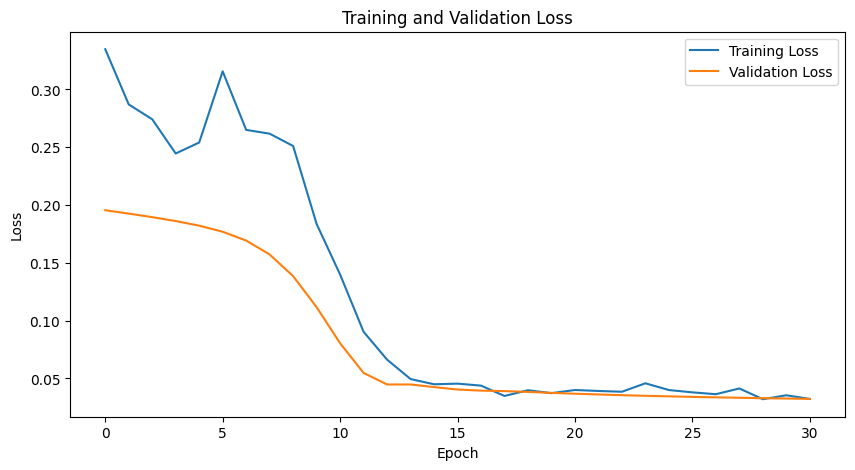

Average PSNR between clear and perturbed images: 30.73 dB
Average PSNR between clear and reconstructed images: 11.60 dB
Average SSIM between clear and perturbed images: 0.7557
Average SSIM between clear and reconstructed images: 0.2668


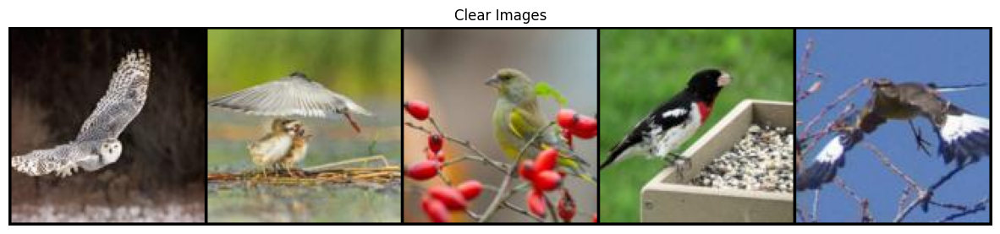

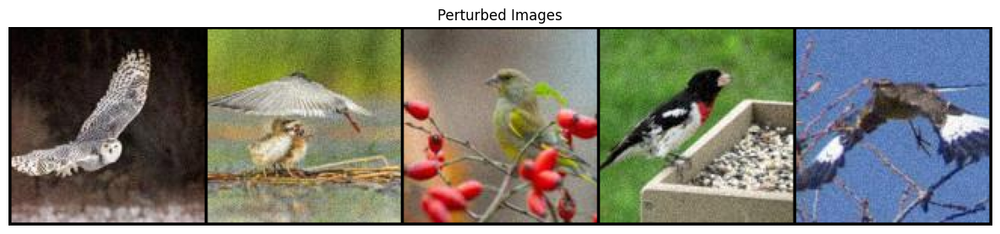

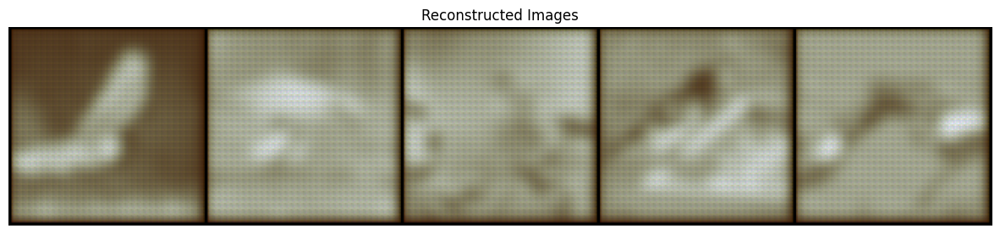

In [110]:
autoencoder = DenoisingConvAutoencoder()

early_stopping = EarlyStopping(
    monitor='val/loss',  # Metrius per monitorare
    patience=10,  # Numero di epoch senza miglioramenti dopo i quali fermare il training
    verbose=True,
    mode='min',  # 'min' per fermare quando la metrica smette di diminuire, 'max' per fermare quando smette di aumentare,
    min_delta=0.005
)

trainer = pl.Trainer(
    max_epochs=50,
    callbacks=[early_stopping]
)

trainer.fit(autoencoder, train_dataloader, val_dataloader)

show_images(autoencoder,size)

## Experiment 2

In [111]:
class DenoisingConvAutoencoder(pl.LightningModule):
    def __init__(self):
        self.validation_results = {
            'inputs': [],
            'perturbed': [],
            'outputs': []
        }
        self.train_step_losses = []
        self.val_step_losses = []
        self.train_losses = []
        self.val_losses = []

        super(DenoisingConvAutoencoder, self).__init__()
        # Encoder

        self.encoder = nn.Sequential(
            nn.Conv2d(3, 8, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
            nn.AvgPool2d(kernel_size=2, stride=2),
            nn.Conv2d(8, 16, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
            nn.AvgPool2d(kernel_size=2, stride=2),
            nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
            nn.AvgPool2d(kernel_size=2, stride=2),
            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
            nn.AvgPool2d(kernel_size=2, stride=2),
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
        )
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(128, 64, 3, stride=2, padding=1, output_padding=1),
            nn.SiLU(),
            nn.ConvTranspose2d(64, 32, 3, stride=2, padding=1, output_padding=1),
            nn.SiLU(),
            nn.ConvTranspose2d(32, 16, 3, stride=2, padding=1, output_padding=1),
            nn.SiLU(),
            nn.ConvTranspose2d(16, 8, 3, stride=2, padding=1, output_padding=1),
            nn.SiLU(),
            nn.Conv2d(8, 3, kernel_size=3, stride=1, padding=1),
        )
        self.criterion = nn.MSELoss()

    def forward(self, x):
        code = self.encoder(x)
        reconstructed = self.decoder(code)
        return code, reconstructed

    def configure_optimizers(self):
        # optimizer = SGD(self.parameters(), lr=0.01, momentum=0.99)
        optimizer = AdamW(self.parameters(), lr = 1e-4, weight_decay=1e-3)
        return optimizer

    def training_step(self, train_batch, batch_idx):
        x_noisy, x_clean = train_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('train/loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.train_step_losses.append(loss.item())
        return loss

    def on_train_epoch_end(self):
        self.train_losses.append(self.train_step_losses[-1])

    def validation_step(self, val_batch, batch_idx):
        x_noisy, x_clean = val_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('val/loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.val_step_losses.append(loss.item())

        self.validation_results['inputs'] = x_clean
        self.validation_results['perturbed'] = x_noisy
        self.validation_results['outputs'] = reconstructed

        return loss

    def on_train_end(self):
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_losses, label='Training Loss')
        plt.plot(self.val_losses[1:], label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Training and Validation Loss')
        plt.legend()
        plt.show()

        torch.save(self.state_dict(), 'models/denoising_conv_autoencoder_v2.pth')

    def on_validation_epoch_end(self):
        self.val_losses.append(min(self.val_step_losses))
    
    def on_train_start(self):
        print()
        # Assicurati che il modello sia sulla CPU per il summary
        if torch.cuda.is_available():
            self.cuda()
        summary(self, (3, 128, 128))

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type       | Params
-----------------------------------------
0 | encoder   | Sequential | 98.4 K
1 | decoder   | Sequential | 98.3 K
2 | criterion | MSELoss    | 0     
-----------------------------------------
196 K     Trainable params
0         Non-trainable params
196 K     Total params
0.787     Total estimated model params size (MB)


Training: |          | 0/? [00:00<?, ?it/s]                                
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 8, 128, 128]             224
              SiLU-2          [-1, 8, 128, 128]               0
         AvgPool2d-3            [-1, 8, 64, 64]               0
            Conv2d-4           [-1, 16, 64, 64]           1,168
              SiLU-5           [-1, 16, 64, 64]               0
         AvgPool2d-6           [-1, 16, 32, 32]               0
            Conv2d-7           [-1, 32, 32, 32]           4,640
              SiLU-8           [-1, 32, 32, 32]               0
         AvgPool2d-9           [-1, 32, 16, 16]               0
           Conv2d-10           [-1, 64, 16, 16]          18,496
             SiLU-11           [-1, 64, 16, 16]               0
        AvgPool2d-12             [-1, 64, 8, 8]               0
           Conv2d-13       

Metric val/loss improved. New best score: 0.301


Epoch 2: 100%|██████████| 13/13 [00:01<00:00,  6.65it/s, v_num=40, train/loss_step=0.287, val/loss_step=0.192, val/loss_epoch=0.292, train/loss_epoch=0.293]

Metric val/loss improved by 0.010 >= min_delta = 0.005. New best score: 0.292


Epoch 3: 100%|██████████| 13/13 [00:01<00:00,  6.69it/s, v_num=40, train/loss_step=0.283, val/loss_step=0.188, val/loss_epoch=0.287, train/loss_epoch=0.288]

Metric val/loss improved by 0.005 >= min_delta = 0.005. New best score: 0.287


Epoch 4: 100%|██████████| 13/13 [00:01<00:00,  6.83it/s, v_num=40, train/loss_step=0.269, val/loss_step=0.183, val/loss_epoch=0.281, train/loss_epoch=0.283]

Metric val/loss improved by 0.006 >= min_delta = 0.005. New best score: 0.281


Epoch 5: 100%|██████████| 13/13 [00:01<00:00,  7.12it/s, v_num=40, train/loss_step=0.257, val/loss_step=0.176, val/loss_epoch=0.270, train/loss_epoch=0.275]

Metric val/loss improved by 0.010 >= min_delta = 0.005. New best score: 0.270


Epoch 6: 100%|██████████| 13/13 [00:02<00:00,  6.49it/s, v_num=40, train/loss_step=0.243, val/loss_step=0.157, val/loss_epoch=0.241, train/loss_epoch=0.259]

Metric val/loss improved by 0.029 >= min_delta = 0.005. New best score: 0.241


Epoch 7: 100%|██████████| 13/13 [00:01<00:00,  7.06it/s, v_num=40, train/loss_step=0.225, val/loss_step=0.139, val/loss_epoch=0.208, train/loss_epoch=0.224]

Metric val/loss improved by 0.033 >= min_delta = 0.005. New best score: 0.208


Epoch 8: 100%|██████████| 13/13 [00:01<00:00,  7.09it/s, v_num=40, train/loss_step=0.161, val/loss_step=0.118, val/loss_epoch=0.176, train/loss_epoch=0.192]

Metric val/loss improved by 0.032 >= min_delta = 0.005. New best score: 0.176


Epoch 9: 100%|██████████| 13/13 [00:01<00:00,  6.98it/s, v_num=40, train/loss_step=0.176, val/loss_step=0.103, val/loss_epoch=0.147, train/loss_epoch=0.162]

Metric val/loss improved by 0.029 >= min_delta = 0.005. New best score: 0.147


Epoch 10: 100%|██████████| 13/13 [00:01<00:00,  7.09it/s, v_num=40, train/loss_step=0.118, val/loss_step=0.0887, val/loss_epoch=0.122, train/loss_epoch=0.136]

Metric val/loss improved by 0.025 >= min_delta = 0.005. New best score: 0.122


Epoch 11: 100%|██████████| 13/13 [00:01<00:00,  7.00it/s, v_num=40, train/loss_step=0.107, val/loss_step=0.0762, val/loss_epoch=0.101, train/loss_epoch=0.112] 

Metric val/loss improved by 0.021 >= min_delta = 0.005. New best score: 0.101


Epoch 12: 100%|██████████| 13/13 [00:01<00:00,  6.75it/s, v_num=40, train/loss_step=0.0866, val/loss_step=0.0653, val/loss_epoch=0.0833, train/loss_epoch=0.0926]

Metric val/loss improved by 0.018 >= min_delta = 0.005. New best score: 0.083


Epoch 13: 100%|██████████| 13/13 [00:01<00:00,  7.07it/s, v_num=40, train/loss_step=0.068, val/loss_step=0.0588, val/loss_epoch=0.0703, train/loss_epoch=0.0771] 

Metric val/loss improved by 0.013 >= min_delta = 0.005. New best score: 0.070


Epoch 14: 100%|██████████| 13/13 [00:01<00:00,  7.02it/s, v_num=40, train/loss_step=0.0534, val/loss_step=0.0519, val/loss_epoch=0.0618, train/loss_epoch=0.0664]

Metric val/loss improved by 0.009 >= min_delta = 0.005. New best score: 0.062


Epoch 16: 100%|██████████| 13/13 [00:01<00:00,  6.99it/s, v_num=40, train/loss_step=0.0506, val/loss_step=0.0454, val/loss_epoch=0.0542, train/loss_epoch=0.056] 

Metric val/loss improved by 0.008 >= min_delta = 0.005. New best score: 0.054


Epoch 20: 100%|██████████| 13/13 [00:01<00:00,  7.04it/s, v_num=40, train/loss_step=0.0519, val/loss_step=0.0428, val/loss_epoch=0.0483, train/loss_epoch=0.0492]

Metric val/loss improved by 0.006 >= min_delta = 0.005. New best score: 0.048


Epoch 25: 100%|██████████| 13/13 [00:01<00:00,  7.10it/s, v_num=40, train/loss_step=0.0454, val/loss_step=0.0376, val/loss_epoch=0.0427, train/loss_epoch=0.0437]

Metric val/loss improved by 0.006 >= min_delta = 0.005. New best score: 0.043


Epoch 30: 100%|██████████| 13/13 [00:01<00:00,  7.00it/s, v_num=40, train/loss_step=0.0466, val/loss_step=0.0359, val/loss_epoch=0.0374, train/loss_epoch=0.0385]

Metric val/loss improved by 0.005 >= min_delta = 0.005. New best score: 0.037


Epoch 40: 100%|██████████| 13/13 [00:02<00:00,  5.10it/s, v_num=40, train/loss_step=0.0272, val/loss_step=0.0337, val/loss_epoch=0.0334, train/loss_epoch=0.0338]

Monitored metric val/loss did not improve in the last 10 records. Best score: 0.037. Signaling Trainer to stop.


Epoch 40: 100%|██████████| 13/13 [00:02<00:00,  5.04it/s, v_num=40, train/loss_step=0.0272, val/loss_step=0.0337, val/loss_epoch=0.0334, train/loss_epoch=0.0338]


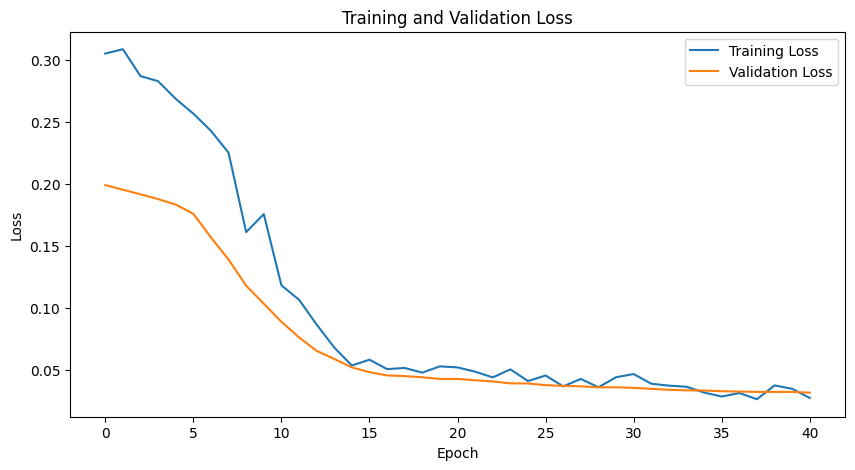

Average PSNR between clear and perturbed images: 30.73 dB
Average PSNR between clear and reconstructed images: 12.06 dB
Average SSIM between clear and perturbed images: 0.7557
Average SSIM between clear and reconstructed images: 0.2942


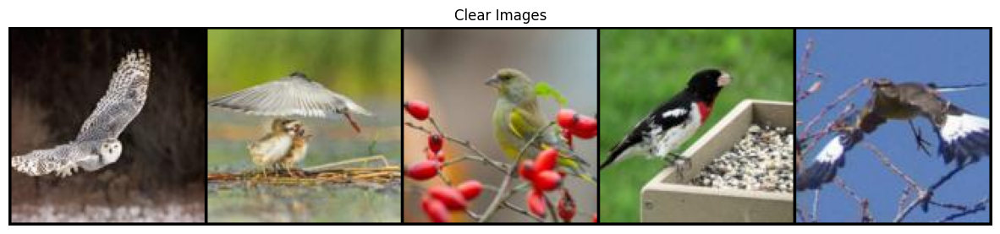

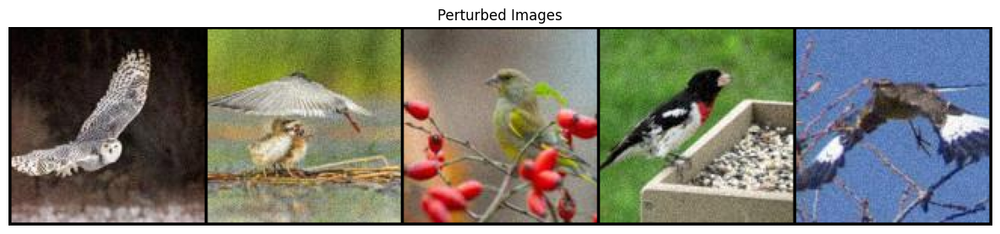

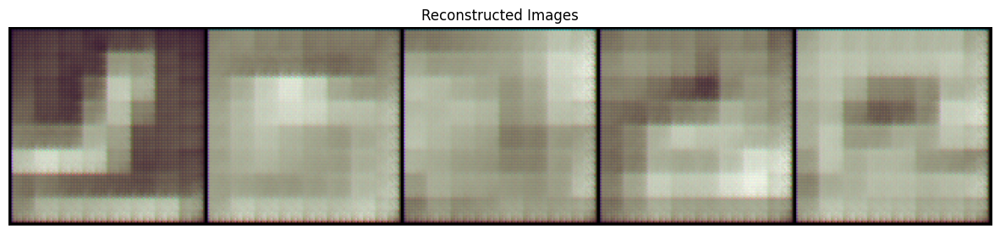

In [112]:
autoencoder = DenoisingConvAutoencoder()

early_stopping = EarlyStopping(
    monitor='val/loss',  # Metrius per monitorare
    patience=10,  # Numero di epoch senza miglioramenti dopo i quali fermare il training
    verbose=True,
    mode='min',  # 'min' per fermare quando la metrica smette di diminuire, 'max' per fermare quando smette di aumentare,
    min_delta=0.005
)

trainer = pl.Trainer(
    max_epochs=50,
    callbacks=[early_stopping]
)

trainer.fit(autoencoder, train_dataloader, val_dataloader)

show_images(autoencoder,size)

## Experiment 3

In [113]:
class DenoisingConvAutoencoder(pl.LightningModule):
    def __init__(self):
        self.validation_results = {
            'inputs': [],
            'perturbed': [],
            'outputs': []
        }
        self.train_step_losses = []
        self.val_step_losses = []
        self.train_losses = []
        self.val_losses = []

        super(DenoisingConvAutoencoder, self).__init__()
        # Encoder

        self.encoder = nn.Sequential(
            nn.Conv2d(3, 8, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
            nn.AvgPool2d(kernel_size=2, stride=2),
            nn.Conv2d(8, 16, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
            nn.AvgPool2d(kernel_size=2, stride=2),
            nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
            nn.AvgPool2d(kernel_size=2, stride=2),
            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
            nn.AvgPool2d(kernel_size=2, stride=2),
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
            nn.AvgPool2d(kernel_size=2, stride=2),
            nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1),
            nn.SiLU(),
        )
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 128, 3, stride=2, padding=1, output_padding=1),
            nn.SiLU(),
            nn.ConvTranspose2d(128, 64, 3, stride=2, padding=1, output_padding=1),
            nn.SiLU(),
            nn.ConvTranspose2d(64, 32, 3, stride=2, padding=1, output_padding=1),
            nn.SiLU(),
            nn.ConvTranspose2d(32, 16, 3, stride=2, padding=1, output_padding=1),
            nn.SiLU(),
            nn.ConvTranspose2d(16, 8, 3, stride=2, padding=1, output_padding=1),
            nn.SiLU(),
            nn.Conv2d(8, 3, kernel_size=3, stride=1, padding=1),
        )
        self.criterion = nn.MSELoss()

    def forward(self, x):
        code = self.encoder(x)
        reconstructed = self.decoder(code)
        return code, reconstructed

    def configure_optimizers(self):
        # optimizer = SGD(self.parameters(), lr=0.01, momentum=0.99)
        optimizer = AdamW(self.parameters(), lr = 1e-4, weight_decay=1e-3)
        return optimizer

    def training_step(self, train_batch, batch_idx):
        x_noisy, x_clean = train_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('train/loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.train_step_losses.append(loss.item())
        return loss

    def on_train_epoch_end(self):
        self.train_losses.append(self.train_step_losses[-1])

    def validation_step(self, val_batch, batch_idx):
        x_noisy, x_clean = val_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('val/loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.val_step_losses.append(loss.item())

        self.validation_results['inputs'] = x_clean
        self.validation_results['perturbed'] = x_noisy
        self.validation_results['outputs'] = reconstructed

        return loss

    def on_train_end(self):
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_losses, label='Training Loss')
        plt.plot(self.val_losses[1:], label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Training and Validation Loss')
        plt.legend()
        plt.show()

        torch.save(self.state_dict(), 'models/denoising_conv_autoencoder_v3.pth')

    def on_validation_epoch_end(self):
        self.val_losses.append(min(self.val_step_losses))
        
    def on_train_start(self):
        print()
        # Assicurati che il modello sia sulla CPU per il summary
        if torch.cuda.is_available():
            self.cuda()
        summary(self, (3, 128, 128))

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type       | Params
-----------------------------------------
0 | encoder   | Sequential | 393 K 
1 | decoder   | Sequential | 393 K 
2 | criterion | MSELoss    | 0     
-----------------------------------------
786 K     Trainable params
0         Non-trainable params
786 K     Total params
3.147     Total estimated model params size (MB)


Training: |          | 0/? [00:00<?, ?it/s]                                
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 8, 128, 128]             224
              SiLU-2          [-1, 8, 128, 128]               0
         AvgPool2d-3            [-1, 8, 64, 64]               0
            Conv2d-4           [-1, 16, 64, 64]           1,168
              SiLU-5           [-1, 16, 64, 64]               0
         AvgPool2d-6           [-1, 16, 32, 32]               0
            Conv2d-7           [-1, 32, 32, 32]           4,640
              SiLU-8           [-1, 32, 32, 32]               0
         AvgPool2d-9           [-1, 32, 16, 16]               0
           Conv2d-10           [-1, 64, 16, 16]          18,496
             SiLU-11           [-1, 64, 16, 16]               0
        AvgPool2d-12             [-1, 64, 8, 8]               0
           Conv2d-13       

Metric val/loss improved. New best score: 0.308


Epoch 1: 100%|██████████| 13/13 [00:02<00:00,  6.49it/s, v_num=41, train/loss_step=0.304, val/loss_step=0.199, val/loss_epoch=0.303, train/loss_epoch=0.305]

Metric val/loss improved by 0.005 >= min_delta = 0.005. New best score: 0.303


Epoch 2: 100%|██████████| 13/13 [00:02<00:00,  6.22it/s, v_num=41, train/loss_step=0.302, val/loss_step=0.195, val/loss_epoch=0.298, train/loss_epoch=0.300]

Metric val/loss improved by 0.005 >= min_delta = 0.005. New best score: 0.298


Epoch 3: 100%|██████████| 13/13 [00:02<00:00,  5.42it/s, v_num=41, train/loss_step=0.319, val/loss_step=0.191, val/loss_epoch=0.292, train/loss_epoch=0.294]

Metric val/loss improved by 0.005 >= min_delta = 0.005. New best score: 0.292


Epoch 4: 100%|██████████| 13/13 [00:02<00:00,  4.54it/s, v_num=41, train/loss_step=0.304, val/loss_step=0.186, val/loss_epoch=0.286, train/loss_epoch=0.288]

Metric val/loss improved by 0.007 >= min_delta = 0.005. New best score: 0.286


Epoch 5: 100%|██████████| 13/13 [00:02<00:00,  6.13it/s, v_num=41, train/loss_step=0.266, val/loss_step=0.173, val/loss_epoch=0.269, train/loss_epoch=0.279]

Metric val/loss improved by 0.017 >= min_delta = 0.005. New best score: 0.269


Epoch 6: 100%|██████████| 13/13 [00:02<00:00,  6.29it/s, v_num=41, train/loss_step=0.206, val/loss_step=0.132, val/loss_epoch=0.203, train/loss_epoch=0.244]

Metric val/loss improved by 0.065 >= min_delta = 0.005. New best score: 0.203


Epoch 7: 100%|██████████| 13/13 [00:02<00:00,  6.06it/s, v_num=41, train/loss_step=0.164, val/loss_step=0.105, val/loss_epoch=0.155, train/loss_epoch=0.180]

Metric val/loss improved by 0.048 >= min_delta = 0.005. New best score: 0.155


Epoch 8: 100%|██████████| 13/13 [00:02<00:00,  6.50it/s, v_num=41, train/loss_step=0.130, val/loss_step=0.0913, val/loss_epoch=0.119, train/loss_epoch=0.137]

Metric val/loss improved by 0.036 >= min_delta = 0.005. New best score: 0.119


Epoch 9: 100%|██████████| 13/13 [00:02<00:00,  5.58it/s, v_num=41, train/loss_step=0.094, val/loss_step=0.0752, val/loss_epoch=0.0956, train/loss_epoch=0.107]

Metric val/loss improved by 0.023 >= min_delta = 0.005. New best score: 0.096


Epoch 10: 100%|██████████| 13/13 [00:02<00:00,  6.13it/s, v_num=41, train/loss_step=0.083, val/loss_step=0.0665, val/loss_epoch=0.0824, train/loss_epoch=0.0881]

Metric val/loss improved by 0.013 >= min_delta = 0.005. New best score: 0.082


Epoch 11: 100%|██████████| 13/13 [00:02<00:00,  6.42it/s, v_num=41, train/loss_step=0.0782, val/loss_step=0.0632, val/loss_epoch=0.0747, train/loss_epoch=0.0775]

Metric val/loss improved by 0.008 >= min_delta = 0.005. New best score: 0.075


Epoch 13: 100%|██████████| 13/13 [00:01<00:00,  6.63it/s, v_num=41, train/loss_step=0.0644, val/loss_step=0.0583, val/loss_epoch=0.0669, train/loss_epoch=0.0676]

Metric val/loss improved by 0.008 >= min_delta = 0.005. New best score: 0.067


Epoch 16: 100%|██████████| 13/13 [00:02<00:00,  6.09it/s, v_num=41, train/loss_step=0.0454, val/loss_step=0.0537, val/loss_epoch=0.0603, train/loss_epoch=0.0607]

Metric val/loss improved by 0.007 >= min_delta = 0.005. New best score: 0.060


Epoch 19: 100%|██████████| 13/13 [00:01<00:00,  6.61it/s, v_num=41, train/loss_step=0.0496, val/loss_step=0.0494, val/loss_epoch=0.0553, train/loss_epoch=0.0555]

Metric val/loss improved by 0.005 >= min_delta = 0.005. New best score: 0.055


Epoch 23: 100%|██████████| 13/13 [00:02<00:00,  6.41it/s, v_num=41, train/loss_step=0.0513, val/loss_step=0.0417, val/loss_epoch=0.0491, train/loss_epoch=0.0497]

Metric val/loss improved by 0.006 >= min_delta = 0.005. New best score: 0.049


Epoch 27: 100%|██████████| 13/13 [00:01<00:00,  6.56it/s, v_num=41, train/loss_step=0.0504, val/loss_step=0.0373, val/loss_epoch=0.0423, train/loss_epoch=0.0435]

Metric val/loss improved by 0.007 >= min_delta = 0.005. New best score: 0.042


Epoch 37: 100%|██████████| 13/13 [00:01<00:00,  6.65it/s, v_num=41, train/loss_step=0.0317, val/loss_step=0.0361, val/loss_epoch=0.0374, train/loss_epoch=0.0378]

Monitored metric val/loss did not improve in the last 10 records. Best score: 0.042. Signaling Trainer to stop.


Epoch 37: 100%|██████████| 13/13 [00:02<00:00,  6.46it/s, v_num=41, train/loss_step=0.0317, val/loss_step=0.0361, val/loss_epoch=0.0374, train/loss_epoch=0.0378]


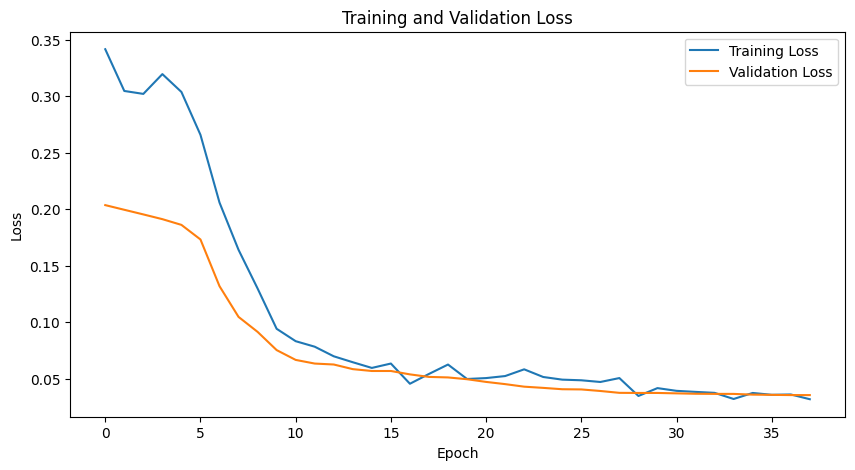

Average PSNR between clear and perturbed images: 30.73 dB
Average PSNR between clear and reconstructed images: 11.45 dB
Average SSIM between clear and perturbed images: 0.7557
Average SSIM between clear and reconstructed images: 0.2590


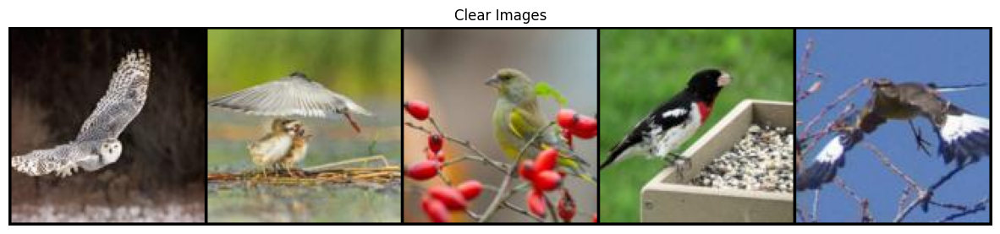

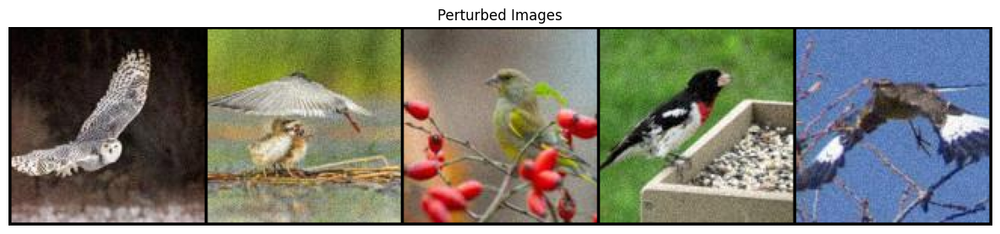

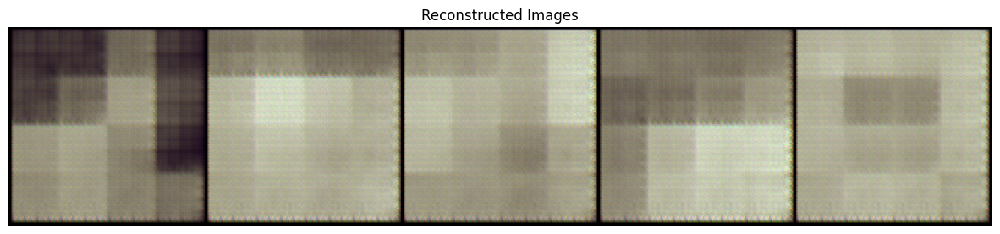

In [114]:
autoencoder = DenoisingConvAutoencoder()

early_stopping = EarlyStopping(
    monitor='val/loss',  # Metrius per monitorare
    patience=10,  # Numero di epoch senza miglioramenti dopo i quali fermare il training
    verbose=True,
    mode='min',  # 'min' per fermare quando la metrica smette di diminuire, 'max' per fermare quando smette di aumentare,
    min_delta=0.005
)

trainer = pl.Trainer(
    max_epochs=50,
    callbacks=[early_stopping]
)

trainer.fit(autoencoder, train_dataloader, val_dataloader)

show_images(autoencoder,size)

## Experiment 4

In [115]:
class DenoisingConvAutoencoder(pl.LightningModule):
    def __init__(self):
        super(DenoisingConvAutoencoder, self).__init__()
        self.validation_results = {
            'inputs': [],
            'perturbed': [],
            'outputs': []
        }
        self.train_step_losses = []
        self.val_step_losses = []
        self.train_losses = []
        self.val_losses = []

        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 16, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 64x64

            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 32x32

            nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2)  # 16x16
        )

        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),

            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),

            nn.ConvTranspose2d(64, 32, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),

            nn.Conv2d(32, 16, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),

            nn.Conv2d(16, 3, kernel_size=3, stride=1, padding=1),
            nn.Tanh()
        )

        self.criterion = nn.MSELoss()

    def forward(self, x):
        code = self.encoder(x)
        reconstructed = self.decoder(code)
        return code, reconstructed

    def configure_optimizers(self):
        optimizer = AdamW(self.parameters(), lr=1e-4, weight_decay=1e-3)
        return optimizer

    def training_step(self, train_batch, batch_idx):
        x_noisy, x_clean = train_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('train/loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.train_step_losses.append(loss.item())
        return loss

    def on_train_epoch_end(self):
        self.train_losses.append(self.train_step_losses[-1])

    def validation_step(self, val_batch, batch_idx):
        x_noisy, x_clean = val_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('val/loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.val_step_losses.append(loss.item())

        self.validation_results['inputs'] = x_clean
        self.validation_results['perturbed'] = x_noisy
        self.validation_results['outputs'] = reconstructed

        return loss

    def on_train_end(self):
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_losses, label='Training Loss')
        plt.plot(self.val_losses[1:], label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Training and Validation Loss')
        plt.legend()
        plt.show()

        torch.save(self.state_dict(), 'models/denoising_conv_autoencoder_v4.pth')

    def on_validation_epoch_end(self):
        self.val_losses.append(min(self.val_step_losses))
        
    def on_train_start(self):
        print()
        # Assicurati che il modello sia sulla CPU per il summary
        if torch.cuda.is_available():
            self.cuda()
        summary(self, (3, 128, 128))

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type       | Params
-----------------------------------------
0 | encoder   | Sequential | 393 K 
1 | decoder   | Sequential | 392 K 
2 | criterion | MSELoss    | 0     
-----------------------------------------
786 K     Trainable params
0         Non-trainable params
786 K     Total params
3.146     Total estimated model params size (MB)


Training: |          | 0/? [00:00<?, ?it/s]                                
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 16, 128, 128]             448
       BatchNorm2d-2         [-1, 16, 128, 128]              32
         LeakyReLU-3         [-1, 16, 128, 128]               0
            Conv2d-4         [-1, 32, 128, 128]           4,640
       BatchNorm2d-5         [-1, 32, 128, 128]              64
         LeakyReLU-6         [-1, 32, 128, 128]               0
         MaxPool2d-7           [-1, 32, 64, 64]               0
            Conv2d-8           [-1, 64, 64, 64]          18,496
       BatchNorm2d-9           [-1, 64, 64, 64]             128
        LeakyReLU-10           [-1, 64, 64, 64]               0
           Conv2d-11          [-1, 128, 64, 64]          73,856
      BatchNorm2d-12          [-1, 128, 64, 64]             256
        LeakyReLU-13       

Metric val/loss improved. New best score: 0.357


Epoch 1: 100%|██████████| 13/13 [00:03<00:00,  3.31it/s, v_num=42, train/loss_step=0.257, val/loss_step=0.207, val/loss_epoch=0.308, train/loss_epoch=0.315]

Metric val/loss improved by 0.049 >= min_delta = 0.005. New best score: 0.308


Epoch 2: 100%|██████████| 13/13 [00:04<00:00,  3.23it/s, v_num=42, train/loss_step=0.225, val/loss_step=0.157, val/loss_epoch=0.231, train/loss_epoch=0.242]

Metric val/loss improved by 0.077 >= min_delta = 0.005. New best score: 0.231


Epoch 3: 100%|██████████| 13/13 [00:03<00:00,  3.29it/s, v_num=42, train/loss_step=0.178, val/loss_step=0.129, val/loss_epoch=0.179, train/loss_epoch=0.198]

Metric val/loss improved by 0.052 >= min_delta = 0.005. New best score: 0.179


Epoch 4: 100%|██████████| 13/13 [00:04<00:00,  3.19it/s, v_num=42, train/loss_step=0.152, val/loss_step=0.108, val/loss_epoch=0.144, train/loss_epoch=0.163]

Metric val/loss improved by 0.035 >= min_delta = 0.005. New best score: 0.144


Epoch 5: 100%|██████████| 13/13 [00:04<00:00,  3.08it/s, v_num=42, train/loss_step=0.124, val/loss_step=0.0822, val/loss_epoch=0.109, train/loss_epoch=0.133]

Metric val/loss improved by 0.035 >= min_delta = 0.005. New best score: 0.109


Epoch 6: 100%|██████████| 13/13 [00:04<00:00,  3.23it/s, v_num=42, train/loss_step=0.103, val/loss_step=0.0667, val/loss_epoch=0.0894, train/loss_epoch=0.108]

Metric val/loss improved by 0.020 >= min_delta = 0.005. New best score: 0.089


Epoch 7: 100%|██████████| 13/13 [00:04<00:00,  3.15it/s, v_num=42, train/loss_step=0.071, val/loss_step=0.0545, val/loss_epoch=0.0719, train/loss_epoch=0.0901]

Metric val/loss improved by 0.017 >= min_delta = 0.005. New best score: 0.072


Epoch 8: 100%|██████████| 13/13 [00:03<00:00,  3.27it/s, v_num=42, train/loss_step=0.0787, val/loss_step=0.0473, val/loss_epoch=0.0627, train/loss_epoch=0.0756]

Metric val/loss improved by 0.009 >= min_delta = 0.005. New best score: 0.063


Epoch 9: 100%|██████████| 13/13 [00:04<00:00,  3.04it/s, v_num=42, train/loss_step=0.0597, val/loss_step=0.0395, val/loss_epoch=0.0532, train/loss_epoch=0.0645]

Metric val/loss improved by 0.010 >= min_delta = 0.005. New best score: 0.053


Epoch 10: 100%|██████████| 13/13 [00:04<00:00,  3.00it/s, v_num=42, train/loss_step=0.0553, val/loss_step=0.035, val/loss_epoch=0.0459, train/loss_epoch=0.0552] 

Metric val/loss improved by 0.007 >= min_delta = 0.005. New best score: 0.046


Epoch 12: 100%|██████████| 13/13 [00:04<00:00,  3.13it/s, v_num=42, train/loss_step=0.0369, val/loss_step=0.0277, val/loss_epoch=0.035, train/loss_epoch=0.0415]

Metric val/loss improved by 0.011 >= min_delta = 0.005. New best score: 0.035


Epoch 15: 100%|██████████| 13/13 [00:04<00:00,  3.20it/s, v_num=42, train/loss_step=0.0332, val/loss_step=0.0227, val/loss_epoch=0.026, train/loss_epoch=0.0283] 

Metric val/loss improved by 0.009 >= min_delta = 0.005. New best score: 0.026


Epoch 19: 100%|██████████| 13/13 [00:04<00:00,  3.24it/s, v_num=42, train/loss_step=0.0152, val/loss_step=0.0201, val/loss_epoch=0.0204, train/loss_epoch=0.0214]

Metric val/loss improved by 0.006 >= min_delta = 0.005. New best score: 0.020


Epoch 29: 100%|██████████| 13/13 [00:04<00:00,  3.25it/s, v_num=42, train/loss_step=0.0184, val/loss_step=0.0189, val/loss_epoch=0.018, train/loss_epoch=0.0176] 

Monitored metric val/loss did not improve in the last 10 records. Best score: 0.020. Signaling Trainer to stop.


Epoch 29: 100%|██████████| 13/13 [00:04<00:00,  3.21it/s, v_num=42, train/loss_step=0.0184, val/loss_step=0.0189, val/loss_epoch=0.018, train/loss_epoch=0.0176]


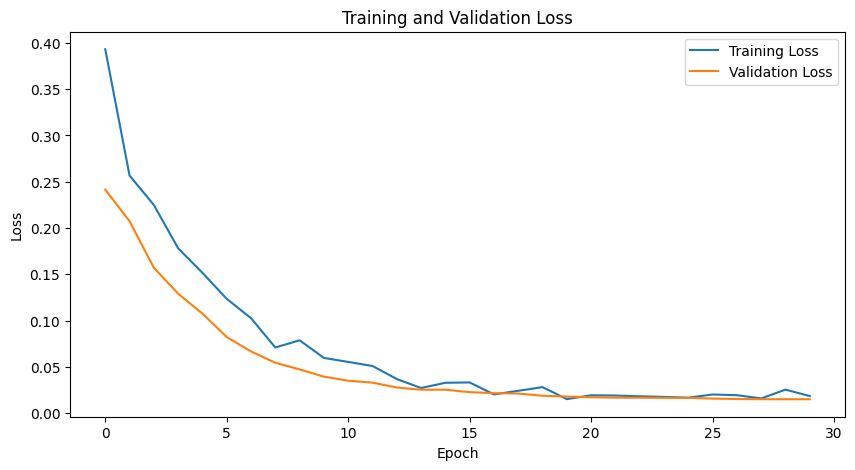

Average PSNR between clear and perturbed images: 30.73 dB
Average PSNR between clear and reconstructed images: 16.55 dB
Average SSIM between clear and perturbed images: 0.7557
Average SSIM between clear and reconstructed images: 0.3638


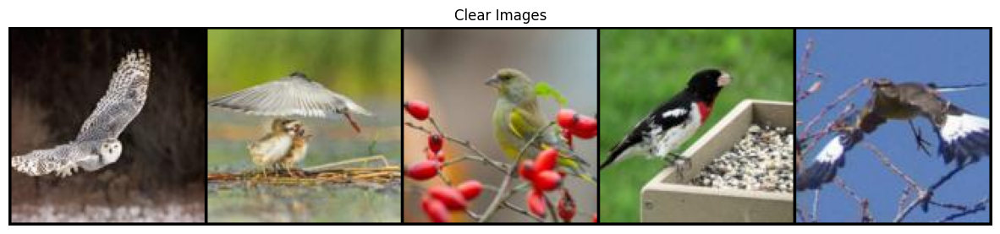

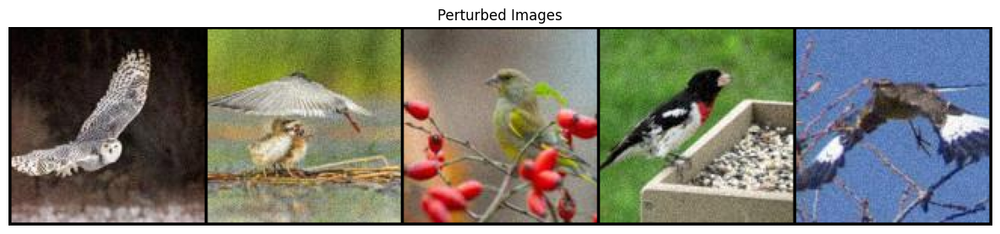

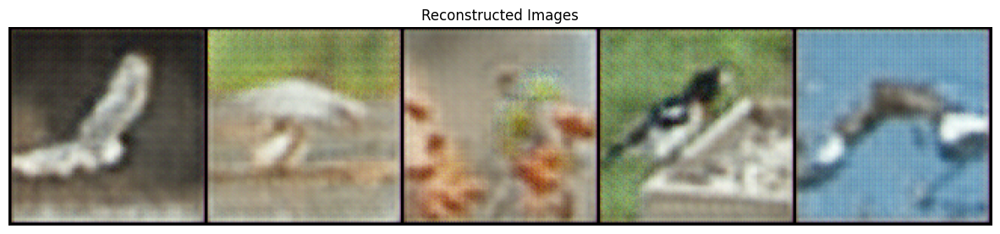

In [116]:
autoencoder = DenoisingConvAutoencoder()

early_stopping = EarlyStopping(
    monitor='val/loss',  # Metrius per monitorare
    patience=10,  # Numero di epoch senza miglioramenti dopo i quali fermare il training
    verbose=True,
    mode='min',  # 'min' per fermare quando la metrica smette di diminuire, 'max' per fermare quando smette di aumentare,
    min_delta=0.005
)

trainer = pl.Trainer(
    max_epochs=50,
    callbacks=[early_stopping]
)

trainer.fit(autoencoder, train_dataloader, val_dataloader)

show_images(autoencoder,size)

## Experiment 5

In [117]:
class DenoisingConvAutoencoder(pl.LightningModule):
    def __init__(self):
        super(DenoisingConvAutoencoder, self).__init__()
        self.validation_results = {
            'inputs': [],
            'perturbed': [],
            'outputs': []
        }
        self.train_step_losses = []
        self.val_step_losses = []
        self.train_losses = []
        self.val_losses = []

        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 16, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 64x64

            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 32x32
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2)  # 16x16
        )

        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),

            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),

            nn.ConvTranspose2d(64, 32, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),

            nn.Conv2d(32, 16, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),

            nn.Conv2d(16, 3, kernel_size=3, stride=1, padding=1),
            nn.Tanh()
        )

        self.criterion = nn.MSELoss()

    def forward(self, x):
        code = self.encoder(x)
        reconstructed = self.decoder(code)
        return code, reconstructed

    def configure_optimizers(self):
        optimizer = AdamW(self.parameters(), lr=1e-4, weight_decay=1e-3)
        return optimizer

    def training_step(self, train_batch, batch_idx):
        x_noisy, x_clean = train_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('train/loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.train_step_losses.append(loss.item())
        return loss

    def on_train_epoch_end(self):
        self.train_losses.append(self.train_step_losses[-1])

    def validation_step(self, val_batch, batch_idx):
        x_noisy, x_clean = val_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('val/loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.val_step_losses.append(loss.item())

        self.validation_results['inputs'] = x_clean
        self.validation_results['perturbed'] = x_noisy
        self.validation_results['outputs'] = reconstructed

        return loss

    def on_train_end(self):
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_losses, label='Training Loss')
        plt.plot(self.val_losses[1:], label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Training and Validation Loss')
        plt.legend()
        plt.show()

        torch.save(self.state_dict(), 'models/denoising_conv_autoencoder_v5.pth')

    def on_validation_epoch_end(self):
        self.val_losses.append(min(self.val_step_losses))
        
    def on_train_start(self):
        print()
        # Assicurati che il modello sia sulla CPU per il summary
        if torch.cuda.is_available():
            self.cuda()
        summary(self, (3, 128, 128))

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type       | Params
-----------------------------------------
0 | encoder   | Sequential | 541 K 
1 | decoder   | Sequential | 540 K 
2 | criterion | MSELoss    | 0     
-----------------------------------------
1.1 M     Trainable params
0         Non-trainable params
1.1 M     Total params
4.328     Total estimated model params size (MB)


Training: |          | 0/? [00:00<?, ?it/s]                                
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 16, 128, 128]             448
       BatchNorm2d-2         [-1, 16, 128, 128]              32
         LeakyReLU-3         [-1, 16, 128, 128]               0
            Conv2d-4         [-1, 32, 128, 128]           4,640
       BatchNorm2d-5         [-1, 32, 128, 128]              64
         LeakyReLU-6         [-1, 32, 128, 128]               0
         MaxPool2d-7           [-1, 32, 64, 64]               0
            Conv2d-8           [-1, 64, 64, 64]          18,496
       BatchNorm2d-9           [-1, 64, 64, 64]             128
        LeakyReLU-10           [-1, 64, 64, 64]               0
           Conv2d-11          [-1, 128, 64, 64]          73,856
      BatchNorm2d-12          [-1, 128, 64, 64]             256
        LeakyReLU-13       

Metric val/loss improved. New best score: 0.244


Epoch 1: 100%|██████████| 13/13 [00:04<00:00,  3.00it/s, v_num=43, train/loss_step=0.184, val/loss_step=0.124, val/loss_epoch=0.194, train/loss_epoch=0.215]

Metric val/loss improved by 0.050 >= min_delta = 0.005. New best score: 0.194


Epoch 2: 100%|██████████| 13/13 [00:04<00:00,  3.00it/s, v_num=43, train/loss_step=0.120, val/loss_step=0.101, val/loss_epoch=0.146, train/loss_epoch=0.162]

Metric val/loss improved by 0.048 >= min_delta = 0.005. New best score: 0.146


Epoch 3: 100%|██████████| 13/13 [00:04<00:00,  3.01it/s, v_num=43, train/loss_step=0.107, val/loss_step=0.0826, val/loss_epoch=0.112, train/loss_epoch=0.125]

Metric val/loss improved by 0.034 >= min_delta = 0.005. New best score: 0.112


Epoch 4: 100%|██████████| 13/13 [00:04<00:00,  3.04it/s, v_num=43, train/loss_step=0.106, val/loss_step=0.0688, val/loss_epoch=0.0919, train/loss_epoch=0.0984]

Metric val/loss improved by 0.020 >= min_delta = 0.005. New best score: 0.092


Epoch 5: 100%|██████████| 13/13 [00:04<00:00,  2.96it/s, v_num=43, train/loss_step=0.0722, val/loss_step=0.056, val/loss_epoch=0.072, train/loss_epoch=0.0781]  

Metric val/loss improved by 0.020 >= min_delta = 0.005. New best score: 0.072


Epoch 6: 100%|██████████| 13/13 [00:04<00:00,  2.93it/s, v_num=43, train/loss_step=0.0636, val/loss_step=0.0465, val/loss_epoch=0.0583, train/loss_epoch=0.0639]

Metric val/loss improved by 0.014 >= min_delta = 0.005. New best score: 0.058


Epoch 7: 100%|██████████| 13/13 [00:04<00:00,  2.96it/s, v_num=43, train/loss_step=0.0681, val/loss_step=0.0378, val/loss_epoch=0.0461, train/loss_epoch=0.0522]

Metric val/loss improved by 0.012 >= min_delta = 0.005. New best score: 0.046


Epoch 8: 100%|██████████| 13/13 [00:04<00:00,  2.97it/s, v_num=43, train/loss_step=0.0397, val/loss_step=0.0324, val/loss_epoch=0.039, train/loss_epoch=0.0445] 

Metric val/loss improved by 0.007 >= min_delta = 0.005. New best score: 0.039


Epoch 10: 100%|██████████| 13/13 [00:04<00:00,  2.99it/s, v_num=43, train/loss_step=0.0268, val/loss_step=0.0273, val/loss_epoch=0.0322, train/loss_epoch=0.0335]

Metric val/loss improved by 0.007 >= min_delta = 0.005. New best score: 0.032


Epoch 11: 100%|██████████| 13/13 [00:04<00:00,  2.95it/s, v_num=43, train/loss_step=0.024, val/loss_step=0.0245, val/loss_epoch=0.0271, train/loss_epoch=0.0294] 

Metric val/loss improved by 0.005 >= min_delta = 0.005. New best score: 0.027


Epoch 15: 100%|██████████| 13/13 [00:04<00:00,  2.96it/s, v_num=43, train/loss_step=0.0194, val/loss_step=0.0206, val/loss_epoch=0.0217, train/loss_epoch=0.0222]

Metric val/loss improved by 0.005 >= min_delta = 0.005. New best score: 0.022


Epoch 25: 100%|██████████| 13/13 [00:04<00:00,  2.76it/s, v_num=43, train/loss_step=0.0159, val/loss_step=0.0186, val/loss_epoch=0.0177, train/loss_epoch=0.0176]

Monitored metric val/loss did not improve in the last 10 records. Best score: 0.022. Signaling Trainer to stop.


Epoch 25: 100%|██████████| 13/13 [00:04<00:00,  2.73it/s, v_num=43, train/loss_step=0.0159, val/loss_step=0.0186, val/loss_epoch=0.0177, train/loss_epoch=0.0176]


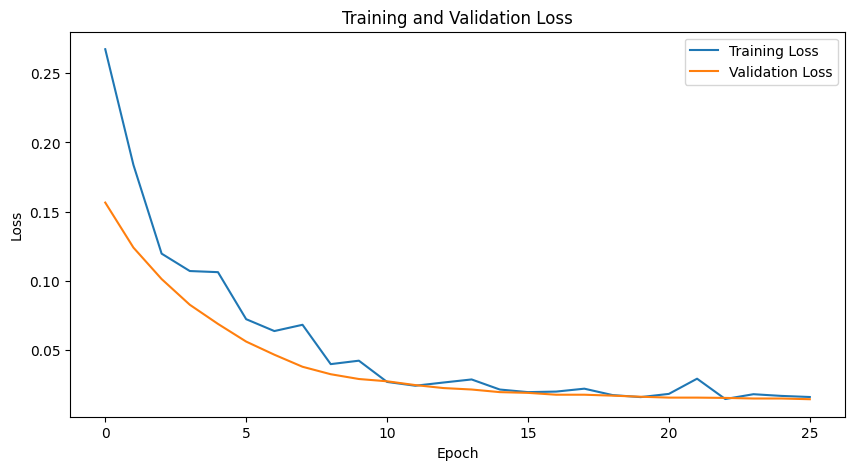

Average PSNR between clear and perturbed images: 30.73 dB
Average PSNR between clear and reconstructed images: 16.41 dB
Average SSIM between clear and perturbed images: 0.7557
Average SSIM between clear and reconstructed images: 0.3443


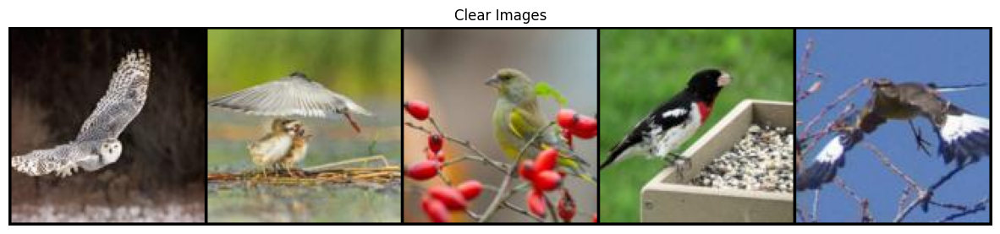

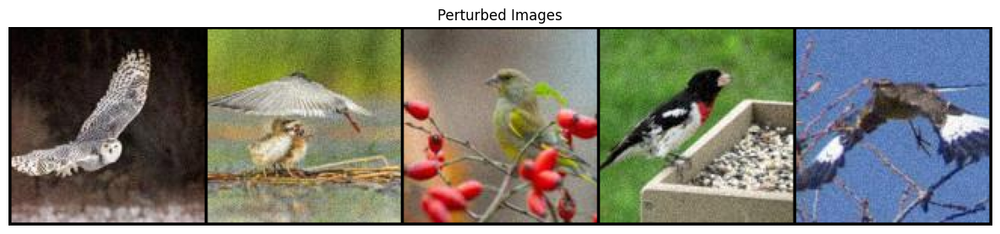

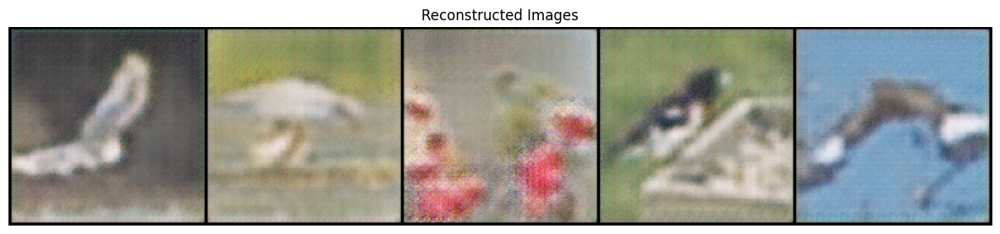

In [118]:
autoencoder = DenoisingConvAutoencoder()

early_stopping = EarlyStopping(
    monitor='val/loss',  # Metrius per monitorare
    patience=10,  # Numero di epoch senza miglioramenti dopo i quali fermare il training
    verbose=True,
    mode='min',  # 'min' per fermare quando la metrica smette di diminuire, 'max' per fermare quando smette di aumentare,
    min_delta=0.005
)

trainer = pl.Trainer(
    max_epochs=50,
    callbacks=[early_stopping]
)

trainer.fit(autoencoder, train_dataloader, val_dataloader)

show_images(autoencoder,size)

## Experiment 6

In [119]:
class DenoisingConvAutoencoder(pl.LightningModule):
    def __init__(self):
        super(DenoisingConvAutoencoder, self).__init__()
        self.validation_results = {
            'inputs': [],
            'perturbed': [],
            'outputs': []
        }
        self.train_step_losses = []
        self.val_step_losses = []
        self.train_losses = []
        self.val_losses = []

        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 16, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 64x64

            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 32x32
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2)  # 16x16
        )

        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose2d(64, 32, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.Conv2d(32, 16, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 3, kernel_size=3, stride=1, padding=1),
            nn.Tanh()
        )

        self.criterion = nn.MSELoss()

    def forward(self, x):
        code = self.encoder(x)
        reconstructed = self.decoder(code)
        return code, reconstructed

    def configure_optimizers(self):
        optimizer = AdamW(self.parameters(), lr=1e-4, weight_decay=1e-3)
        return optimizer

    def training_step(self, train_batch, batch_idx):
        x_noisy, x_clean = train_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('train/loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.train_step_losses.append(loss.item())
        return loss

    def on_train_epoch_end(self):
        self.train_losses.append(self.train_step_losses[-1])

    def validation_step(self, val_batch, batch_idx):
        x_noisy, x_clean = val_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('val/loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.val_step_losses.append(loss.item())

        self.validation_results['inputs'] = x_clean
        self.validation_results['perturbed'] = x_noisy
        self.validation_results['outputs'] = reconstructed

        return loss

    def on_train_end(self):
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_losses, label='Training Loss')
        plt.plot(self.val_losses[1:], label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Training and Validation Loss')
        plt.legend()
        plt.show()

        torch.save(self.state_dict(), 'models/denoising_conv_autoencoder_v6.pth')

    def on_validation_epoch_end(self):
        self.val_losses.append(min(self.val_step_losses))
        
    def on_train_start(self):
        print()
        # Assicurati che il modello sia sulla CPU per il summary
        if torch.cuda.is_available():
            self.cuda()
        summary(self, (3, 128, 128))

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type       | Params
-----------------------------------------
0 | encoder   | Sequential | 689 K 
1 | decoder   | Sequential | 688 K 
2 | criterion | MSELoss    | 0     
-----------------------------------------
1.4 M     Trainable params
0         Non-trainable params
1.4 M     Total params
5.511     Total estimated model params size (MB)


Training: |          | 0/? [00:00<?, ?it/s]                                
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 16, 128, 128]             448
       BatchNorm2d-2         [-1, 16, 128, 128]              32
         LeakyReLU-3         [-1, 16, 128, 128]               0
            Conv2d-4         [-1, 32, 128, 128]           4,640
       BatchNorm2d-5         [-1, 32, 128, 128]              64
         LeakyReLU-6         [-1, 32, 128, 128]               0
         MaxPool2d-7           [-1, 32, 64, 64]               0
            Conv2d-8           [-1, 64, 64, 64]          18,496
       BatchNorm2d-9           [-1, 64, 64, 64]             128
        LeakyReLU-10           [-1, 64, 64, 64]               0
           Conv2d-11          [-1, 128, 64, 64]          73,856
      BatchNorm2d-12          [-1, 128, 64, 64]             256
        LeakyReLU-13       

Metric val/loss improved. New best score: 0.260


Epoch 1: 100%|██████████| 13/13 [00:06<00:00,  2.11it/s, v_num=44, train/loss_step=0.125, val/loss_step=0.121, val/loss_epoch=0.192, train/loss_epoch=0.152]

Metric val/loss improved by 0.068 >= min_delta = 0.005. New best score: 0.192


Epoch 2: 100%|██████████| 13/13 [00:06<00:00,  2.12it/s, v_num=44, train/loss_step=0.0936, val/loss_step=0.0682, val/loss_epoch=0.106, train/loss_epoch=0.104]

Metric val/loss improved by 0.086 >= min_delta = 0.005. New best score: 0.106


Epoch 3: 100%|██████████| 13/13 [00:06<00:00,  2.12it/s, v_num=44, train/loss_step=0.064, val/loss_step=0.050, val/loss_epoch=0.0698, train/loss_epoch=0.0745]

Metric val/loss improved by 0.036 >= min_delta = 0.005. New best score: 0.070


Epoch 4: 100%|██████████| 13/13 [00:06<00:00,  2.09it/s, v_num=44, train/loss_step=0.0461, val/loss_step=0.0366, val/loss_epoch=0.0503, train/loss_epoch=0.0561]

Metric val/loss improved by 0.020 >= min_delta = 0.005. New best score: 0.050


Epoch 5: 100%|██████████| 13/13 [00:06<00:00,  2.09it/s, v_num=44, train/loss_step=0.0355, val/loss_step=0.0291, val/loss_epoch=0.039, train/loss_epoch=0.0441] 

Metric val/loss improved by 0.011 >= min_delta = 0.005. New best score: 0.039


Epoch 6: 100%|██████████| 13/13 [00:06<00:00,  2.07it/s, v_num=44, train/loss_step=0.0298, val/loss_step=0.0262, val/loss_epoch=0.0333, train/loss_epoch=0.0366]

Metric val/loss improved by 0.006 >= min_delta = 0.005. New best score: 0.033


Epoch 8: 100%|██████████| 13/13 [00:06<00:00,  2.15it/s, v_num=44, train/loss_step=0.0296, val/loss_step=0.0228, val/loss_epoch=0.0264, train/loss_epoch=0.0278]

Metric val/loss improved by 0.007 >= min_delta = 0.005. New best score: 0.026


Epoch 11: 100%|██████████| 13/13 [00:06<00:00,  2.11it/s, v_num=44, train/loss_step=0.0249, val/loss_step=0.0202, val/loss_epoch=0.0208, train/loss_epoch=0.022] 

Metric val/loss improved by 0.006 >= min_delta = 0.005. New best score: 0.021


Epoch 21: 100%|██████████| 13/13 [00:06<00:00,  2.10it/s, v_num=44, train/loss_step=0.0184, val/loss_step=0.0203, val/loss_epoch=0.0193, train/loss_epoch=0.0181]

Monitored metric val/loss did not improve in the last 10 records. Best score: 0.021. Signaling Trainer to stop.


Epoch 21: 100%|██████████| 13/13 [00:06<00:00,  2.07it/s, v_num=44, train/loss_step=0.0184, val/loss_step=0.0203, val/loss_epoch=0.0193, train/loss_epoch=0.0181]


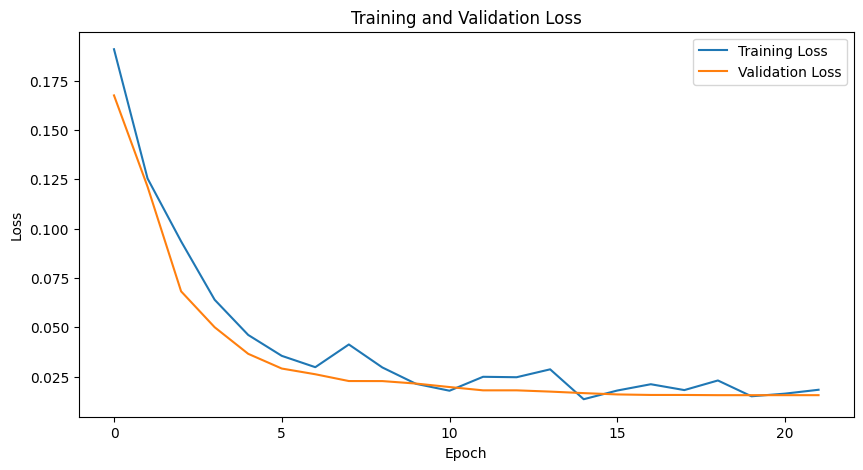

Average PSNR between clear and perturbed images: 30.73 dB
Average PSNR between clear and reconstructed images: 15.11 dB
Average SSIM between clear and perturbed images: 0.7557
Average SSIM between clear and reconstructed images: 0.3251


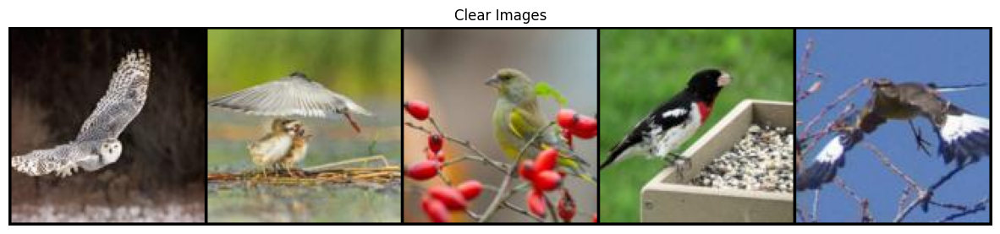

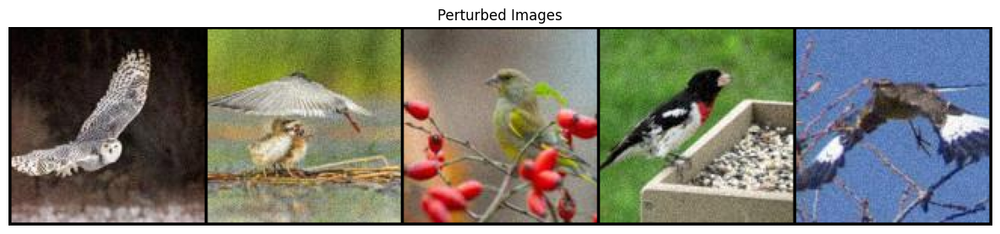

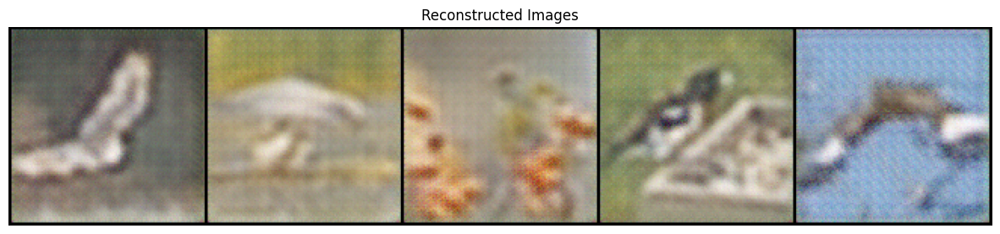

In [120]:
autoencoder = DenoisingConvAutoencoder()

early_stopping = EarlyStopping(
    monitor='val/loss',  # Metrius per monitorare
    patience=10,  # Numero di epoch senza miglioramenti dopo i quali fermare il training
    verbose=True,
    mode='min',  # 'min' per fermare quando la metrica smette di diminuire, 'max' per fermare quando smette di aumentare,
    min_delta=0.005
)

trainer = pl.Trainer(
    max_epochs=50,
    callbacks=[early_stopping]
)

trainer.fit(autoencoder, train_dataloader, val_dataloader)

show_images(autoencoder,size)

## Experiment 7

In [129]:
class DenoisingConvAutoencoder(pl.LightningModule):
    def __init__(self):
        super(DenoisingConvAutoencoder, self).__init__()
        self.validation_results = {
            'inputs': [],
            'perturbed': [],
            'outputs': []
        }
        self.train_step_losses = []
        self.val_step_losses = []
        self.train_losses = []
        self.val_losses = []

        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 16, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 64x64

            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 32x32
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            
            nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.Conv2d(256, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
        )

        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 256, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.Conv2d(32, 16, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 3, kernel_size=3, stride=1, padding=1),
            nn.Tanh()
        )

        self.criterion = nn.MSELoss()

    def forward(self, x):
        code = self.encoder(x)
        reconstructed = self.decoder(code)
        return code, reconstructed

    def configure_optimizers(self):
        optimizer = AdamW(self.parameters(), lr=1e-4, weight_decay=1e-3)
        return optimizer

    def training_step(self, train_batch, batch_idx):
        x_noisy, x_clean = train_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('train/loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.train_step_losses.append(loss.item())
        return loss

    def on_train_epoch_end(self):
        self.train_losses.append(self.train_step_losses[-1])

    def validation_step(self, val_batch, batch_idx):
        x_noisy, x_clean = val_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('val/loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.val_step_losses.append(loss.item())

        self.validation_results['inputs'] = x_clean
        self.validation_results['perturbed'] = x_noisy
        self.validation_results['outputs'] = reconstructed

        return loss

    def on_train_end(self):
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_losses, label='Training Loss')
        plt.plot(self.val_losses[1:], label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Training and Validation Loss')
        plt.legend()
        plt.show()

        torch.save(self.state_dict(), 'models/denoising_conv_autoencoder_v7.pth')

    def on_validation_epoch_end(self):
        self.val_losses.append(min(self.val_step_losses))
        
    def on_train_start(self):
        print()
        # Assicurati che il modello sia sulla CPU per il summary
        if torch.cuda.is_available():
            self.cuda()
        summary(self, (3, 128, 128))

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type       | Params
-----------------------------------------
0 | encoder   | Sequential | 1.1 M 
1 | decoder   | Sequential | 1.1 M 
2 | criterion | MSELoss    | 0     
-----------------------------------------
2.3 M     Trainable params
0         Non-trainable params
2.3 M     Total params
9.053     Total estimated model params size (MB)


Training: |          | 0/? [00:00<?, ?it/s]                                
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 16, 128, 128]             448
       BatchNorm2d-2         [-1, 16, 128, 128]              32
         LeakyReLU-3         [-1, 16, 128, 128]               0
            Conv2d-4         [-1, 32, 128, 128]           4,640
       BatchNorm2d-5         [-1, 32, 128, 128]              64
         LeakyReLU-6         [-1, 32, 128, 128]               0
         MaxPool2d-7           [-1, 32, 64, 64]               0
            Conv2d-8           [-1, 64, 64, 64]          18,496
       BatchNorm2d-9           [-1, 64, 64, 64]             128
        LeakyReLU-10           [-1, 64, 64, 64]               0
           Conv2d-11          [-1, 128, 64, 64]          73,856
      BatchNorm2d-12          [-1, 128, 64, 64]             256
        LeakyReLU-13       

Metric val/loss improved. New best score: 0.264


Epoch 1: 100%|██████████| 13/13 [04:12<00:00,  0.05it/s, v_num=45, train/loss_step=0.109, val/loss_step=0.115, val/loss_epoch=0.183, train/loss_epoch=0.124]

Metric val/loss improved by 0.081 >= min_delta = 0.005. New best score: 0.183


Epoch 2: 100%|██████████| 13/13 [03:52<00:00,  0.06it/s, v_num=45, train/loss_step=0.0884, val/loss_step=0.0603, val/loss_epoch=0.0984, train/loss_epoch=0.0898]

Metric val/loss improved by 0.085 >= min_delta = 0.005. New best score: 0.098


Epoch 3: 100%|██████████| 13/13 [03:56<00:00,  0.05it/s, v_num=45, train/loss_step=0.0702, val/loss_step=0.0406, val/loss_epoch=0.0618, train/loss_epoch=0.0676]

Metric val/loss improved by 0.037 >= min_delta = 0.005. New best score: 0.062


Epoch 4: 100%|██████████| 13/13 [03:58<00:00,  0.05it/s, v_num=45, train/loss_step=0.0559, val/loss_step=0.0294, val/loss_epoch=0.0433, train/loss_epoch=0.0528]

Metric val/loss improved by 0.018 >= min_delta = 0.005. New best score: 0.043


Epoch 5: 100%|██████████| 13/13 [03:54<00:00,  0.06it/s, v_num=45, train/loss_step=0.035, val/loss_step=0.0284, val/loss_epoch=0.0357, train/loss_epoch=0.0424] 

Metric val/loss improved by 0.008 >= min_delta = 0.005. New best score: 0.036


Epoch 6: 100%|██████████| 13/13 [03:56<00:00,  0.06it/s, v_num=45, train/loss_step=0.0249, val/loss_step=0.0254, val/loss_epoch=0.0298, train/loss_epoch=0.0354]

Metric val/loss improved by 0.006 >= min_delta = 0.005. New best score: 0.030


Epoch 8: 100%|██████████| 13/13 [03:54<00:00,  0.06it/s, v_num=45, train/loss_step=0.0204, val/loss_step=0.0191, val/loss_epoch=0.0225, train/loss_epoch=0.0246]

Metric val/loss improved by 0.007 >= min_delta = 0.005. New best score: 0.023


Epoch 13: 100%|██████████| 13/13 [03:55<00:00,  0.06it/s, v_num=45, train/loss_step=0.0162, val/loss_step=0.0173, val/loss_epoch=0.0166, train/loss_epoch=0.0169]

Metric val/loss improved by 0.006 >= min_delta = 0.005. New best score: 0.017


Epoch 23: 100%|██████████| 13/13 [04:07<00:00,  0.05it/s, v_num=45, train/loss_step=0.0126, val/loss_step=0.0164, val/loss_epoch=0.0146, train/loss_epoch=0.0144] 

Monitored metric val/loss did not improve in the last 10 records. Best score: 0.017. Signaling Trainer to stop.


Epoch 23: 100%|██████████| 13/13 [04:07<00:00,  0.05it/s, v_num=45, train/loss_step=0.0126, val/loss_step=0.0164, val/loss_epoch=0.0146, train/loss_epoch=0.0144]


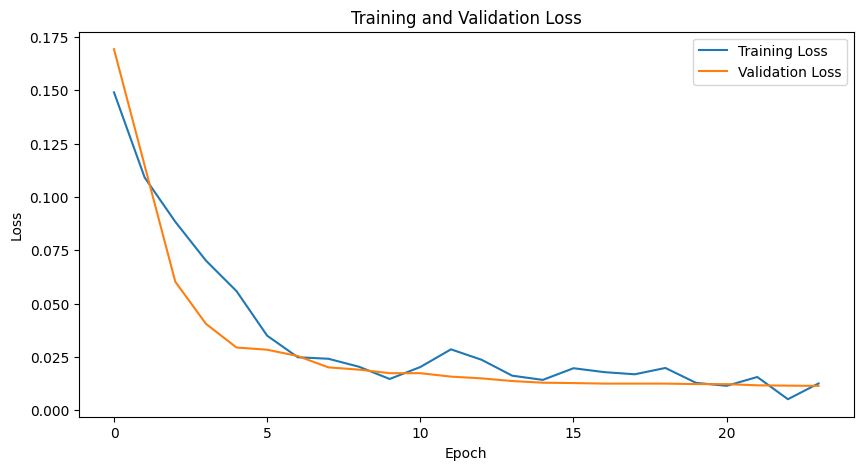

Average PSNR between clear and perturbed images: 30.73 dB
Average PSNR between clear and reconstructed images: 17.72 dB
Average SSIM between clear and perturbed images: 0.7557
Average SSIM between clear and reconstructed images: 0.4765


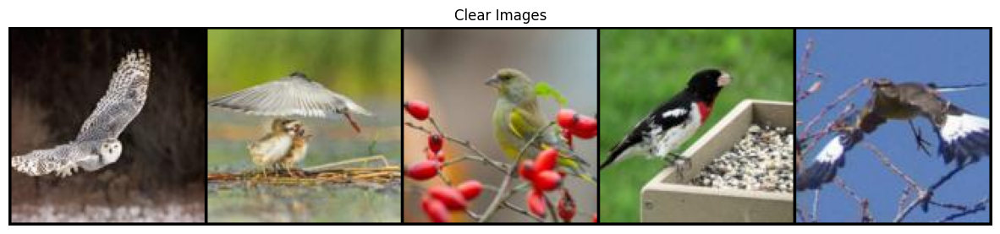

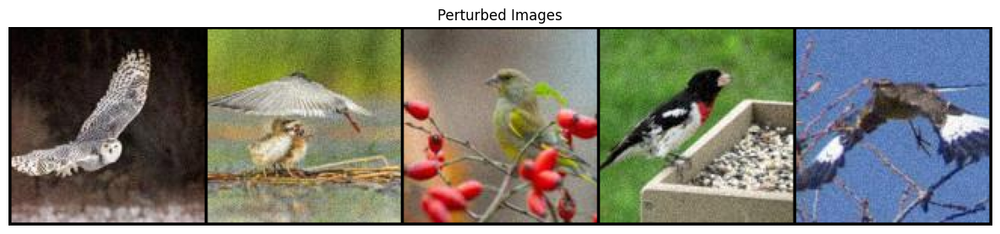

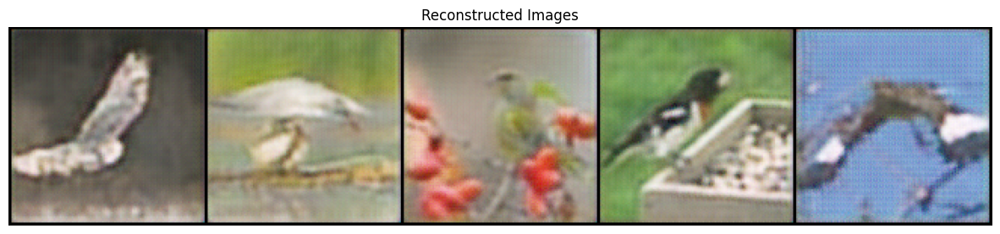

In [122]:
autoencoder = DenoisingConvAutoencoder()

early_stopping = EarlyStopping(
    monitor='val/loss',  # Metrius per monitorare
    patience=10,  # Numero di epoch senza miglioramenti dopo i quali fermare il training
    verbose=True,
    mode='min',  # 'min' per fermare quando la metrica smette di diminuire, 'max' per fermare quando smette di aumentare,
    min_delta=0.005
)

trainer = pl.Trainer(
    max_epochs=50,
    callbacks=[early_stopping]
)

trainer.fit(autoencoder, train_dataloader, val_dataloader)

show_images(autoencoder,size)

## Experiment 8

In [123]:
class DenoisingConvAutoencoder(pl.LightningModule):
    def __init__(self):
        super(DenoisingConvAutoencoder, self).__init__()
        self.validation_results = {
            'inputs': [],
            'perturbed': [],
            'outputs': []
        }
        self.train_step_losses = []
        self.val_step_losses = []
        self.train_losses = []
        self.val_losses = []

        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 16, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 64x64

            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 32x32
            nn.Conv2d(256, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
        )

        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 256, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.Conv2d(32, 16, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 3, kernel_size=3, stride=1, padding=1),
            nn.Tanh()
        )

        self.criterion = nn.MSELoss()

    def forward(self, x):
        code = self.encoder(x)
        reconstructed = self.decoder(code)
        return code, reconstructed

    def configure_optimizers(self):
        optimizer = AdamW(self.parameters(), lr=1e-4, weight_decay=1e-3)
        return optimizer

    def training_step(self, train_batch, batch_idx):
        x_noisy, x_clean = train_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('train/loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.train_step_losses.append(loss.item())
        return loss

    def on_train_epoch_end(self):
        self.train_losses.append(self.train_step_losses[-1])

    def validation_step(self, val_batch, batch_idx):
        x_noisy, x_clean = val_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('val/loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.val_step_losses.append(loss.item())

        self.validation_results['inputs'] = x_clean
        self.validation_results['perturbed'] = x_noisy
        self.validation_results['outputs'] = reconstructed

        return loss

    def on_train_end(self):
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_losses, label='Training Loss')
        plt.plot(self.val_losses[1:], label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Training and Validation Loss')
        plt.legend()
        plt.show()

        torch.save(self.state_dict(), 'models/denoising_conv_autoencoder_v8.pth')

    def on_validation_epoch_end(self):
        self.val_losses.append(min(self.val_step_losses))
        
    def on_train_start(self):
        print()
        # Assicurati che il modello sia sulla CPU per il summary
        if torch.cuda.is_available():
            self.cuda()
        summary(self, (3, 128, 128))

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type       | Params
-----------------------------------------
0 | encoder   | Sequential | 1.1 M 
1 | decoder   | Sequential | 1.1 M 
2 | criterion | MSELoss    | 0     
-----------------------------------------
2.3 M     Trainable params
0         Non-trainable params
2.3 M     Total params
9.053     Total estimated model params size (MB)


Training: |          | 0/? [00:00<?, ?it/s]                                
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 16, 128, 128]             448
       BatchNorm2d-2         [-1, 16, 128, 128]              32
         LeakyReLU-3         [-1, 16, 128, 128]               0
            Conv2d-4         [-1, 32, 128, 128]           4,640
       BatchNorm2d-5         [-1, 32, 128, 128]              64
         LeakyReLU-6         [-1, 32, 128, 128]               0
         MaxPool2d-7           [-1, 32, 64, 64]               0
            Conv2d-8           [-1, 64, 64, 64]          18,496
       BatchNorm2d-9           [-1, 64, 64, 64]             128
        LeakyReLU-10           [-1, 64, 64, 64]               0
           Conv2d-11          [-1, 128, 64, 64]          73,856
      BatchNorm2d-12          [-1, 128, 64, 64]             256
        LeakyReLU-13       

Metric val/loss improved. New best score: 0.245


Epoch 1: 100%|██████████| 13/13 [04:30<00:00,  0.05it/s, v_num=46, train/loss_step=0.114, val/loss_step=0.118, val/loss_epoch=0.180, train/loss_epoch=0.140]

Metric val/loss improved by 0.064 >= min_delta = 0.005. New best score: 0.180


Epoch 2: 100%|██████████| 13/13 [04:15<00:00,  0.05it/s, v_num=46, train/loss_step=0.0919, val/loss_step=0.0791, val/loss_epoch=0.117, train/loss_epoch=0.102]

Metric val/loss improved by 0.063 >= min_delta = 0.005. New best score: 0.117


Epoch 3: 100%|██████████| 13/13 [04:12<00:00,  0.05it/s, v_num=46, train/loss_step=0.073, val/loss_step=0.0515, val/loss_epoch=0.0787, train/loss_epoch=0.0751]

Metric val/loss improved by 0.039 >= min_delta = 0.005. New best score: 0.079


Epoch 4: 100%|██████████| 13/13 [04:12<00:00,  0.05it/s, v_num=46, train/loss_step=0.0498, val/loss_step=0.0374, val/loss_epoch=0.0526, train/loss_epoch=0.0557]

Metric val/loss improved by 0.026 >= min_delta = 0.005. New best score: 0.053


Epoch 5: 100%|██████████| 13/13 [04:12<00:00,  0.05it/s, v_num=46, train/loss_step=0.0299, val/loss_step=0.027, val/loss_epoch=0.0372, train/loss_epoch=0.0418] 

Metric val/loss improved by 0.015 >= min_delta = 0.005. New best score: 0.037


Epoch 6: 100%|██████████| 13/13 [04:12<00:00,  0.05it/s, v_num=46, train/loss_step=0.0386, val/loss_step=0.0255, val/loss_epoch=0.0319, train/loss_epoch=0.0325]

Metric val/loss improved by 0.005 >= min_delta = 0.005. New best score: 0.032


Epoch 7: 100%|██████████| 13/13 [04:12<00:00,  0.05it/s, v_num=46, train/loss_step=0.0232, val/loss_step=0.0204, val/loss_epoch=0.024, train/loss_epoch=0.0266] 

Metric val/loss improved by 0.008 >= min_delta = 0.005. New best score: 0.024


Epoch 10: 100%|██████████| 13/13 [04:12<00:00,  0.05it/s, v_num=46, train/loss_step=0.0135, val/loss_step=0.0185, val/loss_epoch=0.0189, train/loss_epoch=0.0186]

Metric val/loss improved by 0.005 >= min_delta = 0.005. New best score: 0.019


Epoch 20: 100%|██████████| 13/13 [04:13<00:00,  0.05it/s, v_num=46, train/loss_step=0.0187, val/loss_step=0.0176, val/loss_epoch=0.015, train/loss_epoch=0.0146]  

Monitored metric val/loss did not improve in the last 10 records. Best score: 0.019. Signaling Trainer to stop.


Epoch 20: 100%|██████████| 13/13 [04:13<00:00,  0.05it/s, v_num=46, train/loss_step=0.0187, val/loss_step=0.0176, val/loss_epoch=0.015, train/loss_epoch=0.0146]


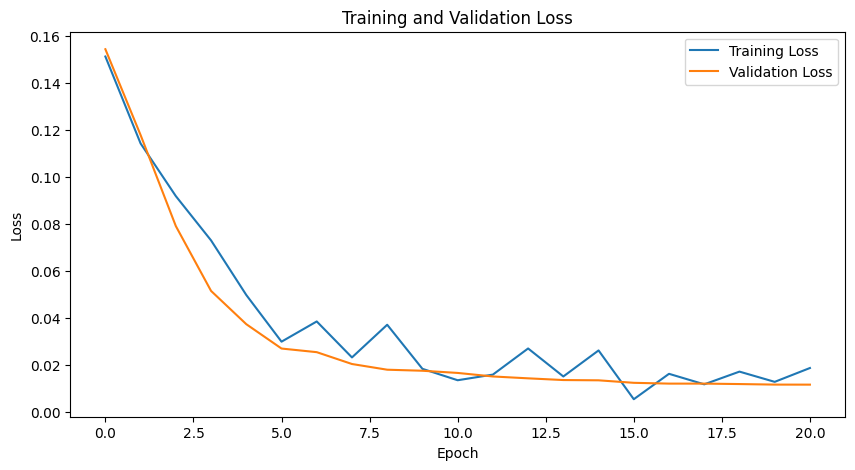

Average PSNR between clear and perturbed images: 30.73 dB
Average PSNR between clear and reconstructed images: 17.83 dB
Average SSIM between clear and perturbed images: 0.7557
Average SSIM between clear and reconstructed images: 0.4713


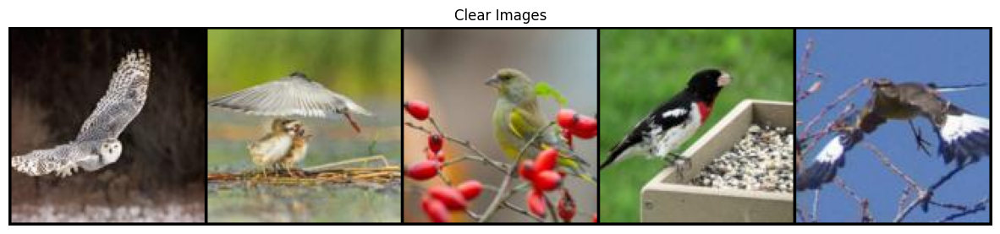

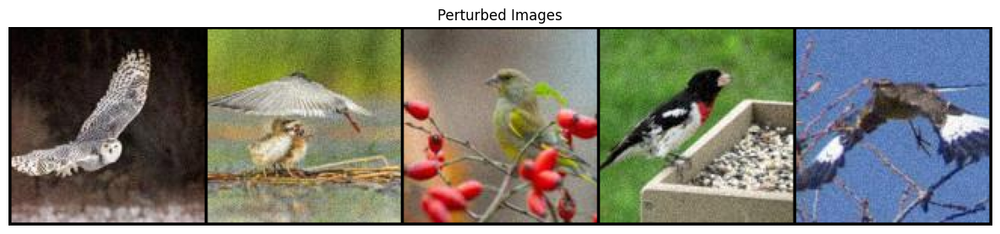

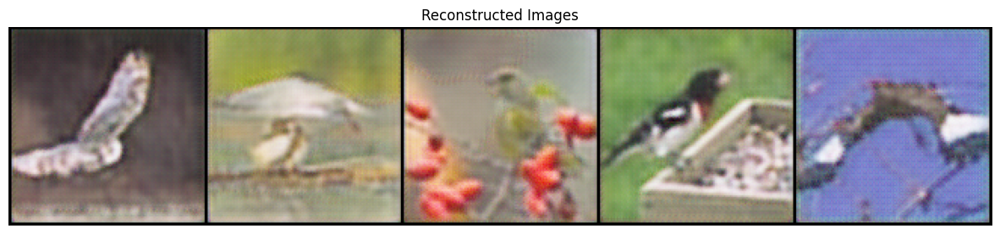

In [124]:
autoencoder = DenoisingConvAutoencoder()

early_stopping = EarlyStopping(
    monitor='val/loss',  # Metrius per monitorare
    patience=10,  # Numero di epoch senza miglioramenti dopo i quali fermare il training
    verbose=True,
    mode='min',  # 'min' per fermare quando la metrica smette di diminuire, 'max' per fermare quando smette di aumentare,
    min_delta=0.005
)

trainer = pl.Trainer(
    max_epochs=50,
    callbacks=[early_stopping]
)

trainer.fit(autoencoder, train_dataloader, val_dataloader)

show_images(autoencoder,size)

## Experiment 9

In [125]:
class DenoisingConvAutoencoder(pl.LightningModule):
    def __init__(self):
        super(DenoisingConvAutoencoder, self).__init__()
        self.validation_results = {
            'inputs': [],
            'perturbed': [],
            'outputs': []
        }
        self.train_step_losses = []
        self.val_step_losses = []
        self.train_losses = []
        self.val_losses = []

        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 16, kernel_size=7, stride=1, padding=4),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 32, kernel_size=5, stride=1, padding=2),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 64x64

            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 32x32
            nn.Conv2d(256, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
        )

        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 256, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.Conv2d(32, 16, kernel_size=5, stride=1, padding=3),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 3, kernel_size=7, stride=1, padding=2),
            nn.Tanh()
        )

        self.criterion = nn.MSELoss()

    def forward(self, x):
        code = self.encoder(x)
        reconstructed = self.decoder(code)
        return code, reconstructed

    def configure_optimizers(self):
        optimizer = AdamW(self.parameters(), lr=1e-4, weight_decay=1e-3)
        return optimizer

    def training_step(self, train_batch, batch_idx):
        x_noisy, x_clean = train_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('train/loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.train_step_losses.append(loss.item())
        return loss

    def on_train_epoch_end(self):
        self.train_losses.append(self.train_step_losses[-1])

    def validation_step(self, val_batch, batch_idx):
        x_noisy, x_clean = val_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('val/loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.val_step_losses.append(loss.item())

        self.validation_results['inputs'] = x_clean
        self.validation_results['perturbed'] = x_noisy
        self.validation_results['outputs'] = reconstructed

        return loss

    def on_train_end(self):
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_losses, label='Training Loss')
        plt.plot(self.val_losses[1:], label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Training and Validation Loss')
        plt.legend()
        plt.show()

        torch.save(self.state_dict(), 'models/denoising_conv_autoencoder_v9.pth')

    def on_validation_epoch_end(self):
        self.val_losses.append(min(self.val_step_losses))
        
    def on_train_start(self):
        print()
        # Assicurati che il modello sia sulla CPU per il summary
        if torch.cuda.is_available():
            self.cuda()
        summary(self, (3, 128, 128))

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type       | Params
-----------------------------------------
0 | encoder   | Sequential | 1.1 M 
1 | decoder   | Sequential | 1.1 M 
2 | criterion | MSELoss    | 0     
-----------------------------------------
2.3 M     Trainable params
0         Non-trainable params
2.3 M     Total params
9.134     Total estimated model params size (MB)


Training: |          | 0/? [00:00<?, ?it/s]                                
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 16, 130, 130]           2,368
       BatchNorm2d-2         [-1, 16, 130, 130]              32
         LeakyReLU-3         [-1, 16, 130, 130]               0
            Conv2d-4         [-1, 32, 130, 130]          12,832
       BatchNorm2d-5         [-1, 32, 130, 130]              64
         LeakyReLU-6         [-1, 32, 130, 130]               0
         MaxPool2d-7           [-1, 32, 65, 65]               0
            Conv2d-8           [-1, 64, 65, 65]          18,496
       BatchNorm2d-9           [-1, 64, 65, 65]             128
        LeakyReLU-10           [-1, 64, 65, 65]               0
           Conv2d-11          [-1, 128, 65, 65]          73,856
      BatchNorm2d-12          [-1, 128, 65, 65]             256
        LeakyReLU-13       

Metric val/loss improved. New best score: 0.204


Epoch 1: 100%|██████████| 13/13 [04:49<00:00,  0.04it/s, v_num=47, train/loss_step=0.0278, val/loss_step=0.045, val/loss_epoch=0.0741, train/loss_epoch=0.0505]

Metric val/loss improved by 0.129 >= min_delta = 0.005. New best score: 0.074


Epoch 2: 100%|██████████| 13/13 [04:48<00:00,  0.05it/s, v_num=47, train/loss_step=0.0256, val/loss_step=0.0234, val/loss_epoch=0.0269, train/loss_epoch=0.0249]

Metric val/loss improved by 0.047 >= min_delta = 0.005. New best score: 0.027


Epoch 3: 100%|██████████| 13/13 [04:48<00:00,  0.04it/s, v_num=47, train/loss_step=0.0273, val/loss_step=0.0212, val/loss_epoch=0.0197, train/loss_epoch=0.0205]

Metric val/loss improved by 0.007 >= min_delta = 0.005. New best score: 0.020


Epoch 13: 100%|██████████| 13/13 [04:49<00:00,  0.04it/s, v_num=47, train/loss_step=0.012, val/loss_step=0.0171, val/loss_epoch=0.0162, train/loss_epoch=0.0155] 

Monitored metric val/loss did not improve in the last 10 records. Best score: 0.020. Signaling Trainer to stop.


Epoch 13: 100%|██████████| 13/13 [04:49<00:00,  0.04it/s, v_num=47, train/loss_step=0.012, val/loss_step=0.0171, val/loss_epoch=0.0162, train/loss_epoch=0.0155]


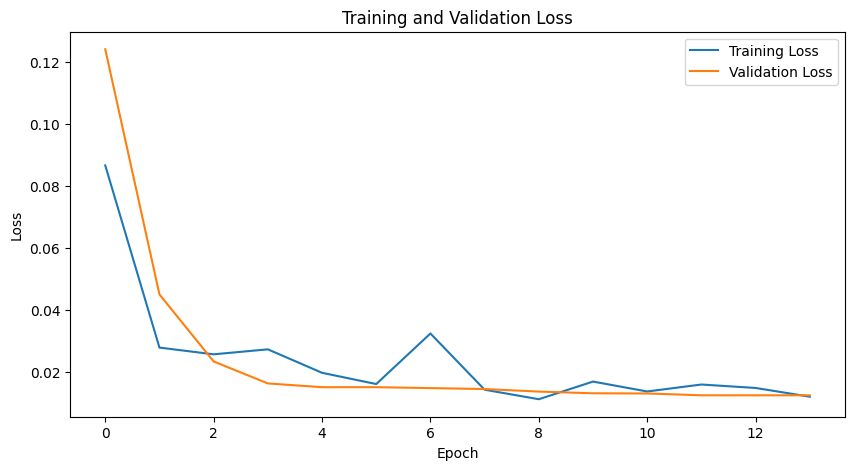

Average PSNR between clear and perturbed images: 30.73 dB
Average PSNR between clear and reconstructed images: 17.78 dB
Average SSIM between clear and perturbed images: 0.7557
Average SSIM between clear and reconstructed images: 0.4483


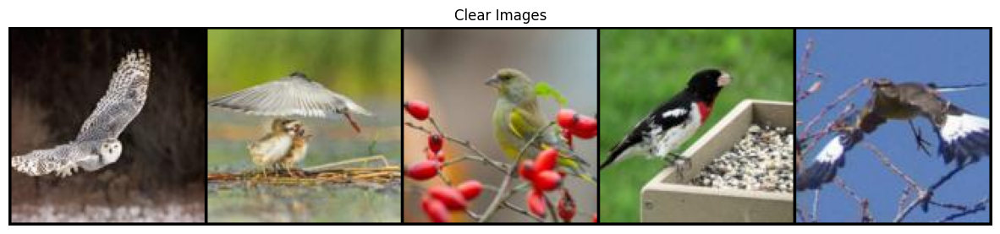

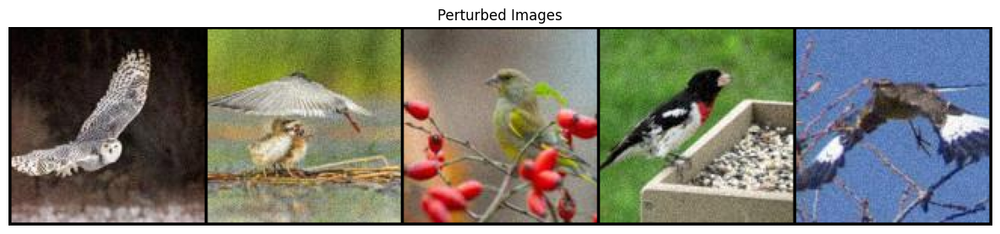

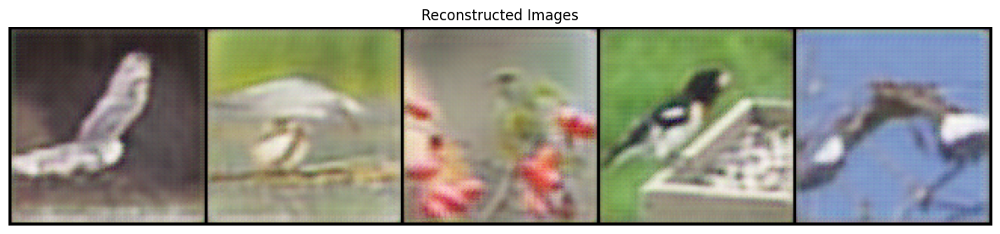

In [126]:
autoencoder = DenoisingConvAutoencoder()

early_stopping = EarlyStopping(
    monitor='val/loss',  # Metrius per monitorare
    patience=10,  # Numero di epoch senza miglioramenti dopo i quali fermare il training
    verbose=True,
    mode='min',  # 'min' per fermare quando la metrica smette di diminuire, 'max' per fermare quando smette di aumentare,
    min_delta=0.005
)

trainer = pl.Trainer(
    max_epochs=50,
    callbacks=[early_stopping]
)

trainer.fit(autoencoder, train_dataloader, val_dataloader)

show_images(autoencoder,size)

## Experiment 10

In [166]:
class DenoisingConvAutoencoder(pl.LightningModule):
    def __init__(self):
        super(DenoisingConvAutoencoder, self).__init__()
        self.validation_results = {
            'inputs': [],
            'perturbed': [],
            'outputs': []
        }
        self.train_step_losses = []
        self.val_step_losses = []
        self.train_losses = []
        self.val_losses = []

        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 16, kernel_size=7, stride=1, padding=3),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 32, kernel_size=5, stride=1, padding=2),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 64x64
            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
        )

        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.Conv2d(32, 16, kernel_size=5, stride=1, padding=3),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 3, kernel_size=7, stride=1, padding=2),
            nn.Tanh()
        )

        self.criterion = nn.MSELoss()

    def forward(self, x):
        code = self.encoder(x)
        reconstructed = self.decoder(code)
        return code, reconstructed

    def configure_optimizers(self):
        optimizer = AdamW(self.parameters(), lr=1e-4, weight_decay=1e-3)
        return optimizer

    def training_step(self, train_batch, batch_idx):
        x_noisy, x_clean = train_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('train/loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.train_step_losses.append(loss.item())
        return loss

    def on_train_epoch_end(self):
        self.train_losses.append(self.train_step_losses[-1])

    def validation_step(self, val_batch, batch_idx):
        x_noisy, x_clean = val_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('val/loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.val_step_losses.append(loss.item())

        self.validation_results['inputs'] = x_clean
        self.validation_results['perturbed'] = x_noisy
        self.validation_results['outputs'] = reconstructed

        return loss

    def on_train_end(self):
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_losses, label='Training Loss')
        plt.plot(self.val_losses[1:], label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Training and Validation Loss')
        plt.legend()
        plt.show()

        torch.save(self.state_dict(), 'models/denoising_conv_autoencoder_v10.pth')

    def on_validation_epoch_end(self):
        self.val_losses.append(min(self.val_step_losses))
        
    def on_train_start(self):
        print()
        # Assicurati che il modello sia sulla CPU per il summary
        if torch.cuda.is_available():
            self.cuda()
        summary(self, (3, 128, 128))

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type       | Params
-----------------------------------------
0 | encoder   | Sequential | 403 K 
1 | decoder   | Sequential | 402 K 
2 | criterion | MSELoss    | 0     
-----------------------------------------
806 K     Trainable params
0         Non-trainable params
806 K     Total params
3.227     Total estimated model params size (MB)


Training: |          | 0/? [00:00<?, ?it/s]                                
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 16, 128, 128]           2,368
       BatchNorm2d-2         [-1, 16, 128, 128]              32
         LeakyReLU-3         [-1, 16, 128, 128]               0
            Conv2d-4         [-1, 32, 128, 128]          12,832
       BatchNorm2d-5         [-1, 32, 128, 128]              64
         LeakyReLU-6         [-1, 32, 128, 128]               0
         MaxPool2d-7           [-1, 32, 64, 64]               0
            Conv2d-8           [-1, 64, 64, 64]          18,496
       BatchNorm2d-9           [-1, 64, 64, 64]             128
        LeakyReLU-10           [-1, 64, 64, 64]               0
           Conv2d-11          [-1, 128, 64, 64]          73,856
      BatchNorm2d-12          [-1, 128, 64, 64]             256
        LeakyReLU-13       

Metric val/loss improved. New best score: 0.200


Epoch 1: 100%|██████████| 13/13 [02:04<00:00,  0.10it/s, v_num=48, train/loss_step=0.0273, val/loss_step=0.0402, val/loss_epoch=0.0548, train/loss_epoch=0.0381]

Metric val/loss improved by 0.145 >= min_delta = 0.005. New best score: 0.055


Epoch 2: 100%|██████████| 13/13 [01:59<00:00,  0.11it/s, v_num=48, train/loss_step=0.0104, val/loss_step=0.0239, val/loss_epoch=0.0215, train/loss_epoch=0.0207]

Metric val/loss improved by 0.033 >= min_delta = 0.005. New best score: 0.021


Epoch 6: 100%|██████████| 13/13 [01:59<00:00,  0.11it/s, v_num=48, train/loss_step=0.00556, val/loss_step=0.0186, val/loss_epoch=0.0165, train/loss_epoch=0.0161]

Metric val/loss improved by 0.005 >= min_delta = 0.005. New best score: 0.016


Epoch 16: 100%|██████████| 13/13 [01:59<00:00,  0.11it/s, v_num=48, train/loss_step=0.0151, val/loss_step=0.0158, val/loss_epoch=0.0143, train/loss_epoch=0.0143]

Monitored metric val/loss did not improve in the last 10 records. Best score: 0.016. Signaling Trainer to stop.


Epoch 16: 100%|██████████| 13/13 [01:59<00:00,  0.11it/s, v_num=48, train/loss_step=0.0151, val/loss_step=0.0158, val/loss_epoch=0.0143, train/loss_epoch=0.0143]


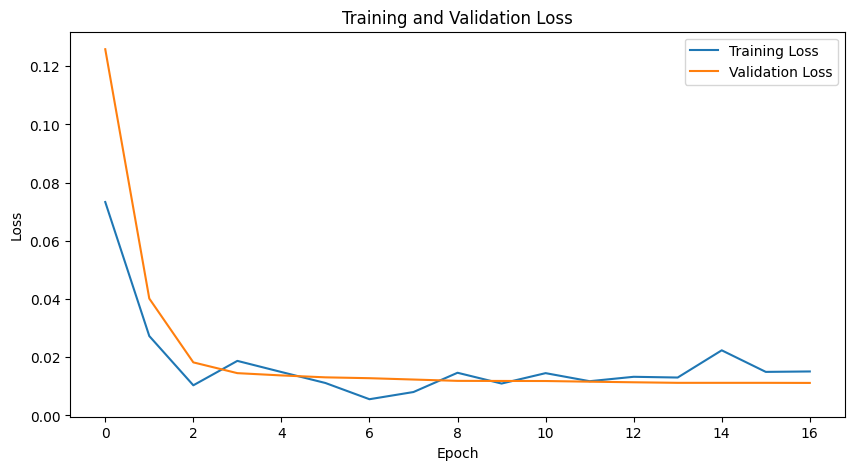

Average PSNR between clear and perturbed images: 30.73 dB
Average PSNR between clear and reconstructed images: 16.85 dB
Average SSIM between clear and perturbed images: 0.7557
Average SSIM between clear and reconstructed images: 0.4980


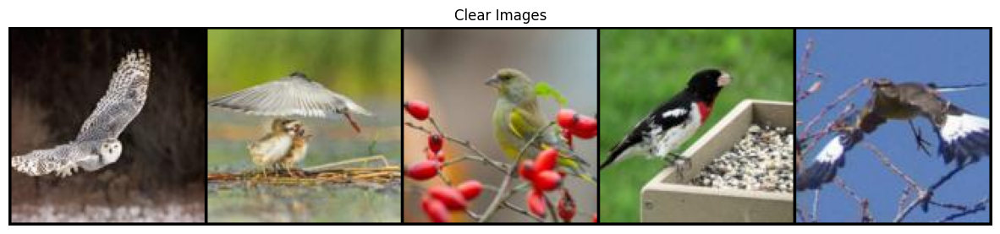

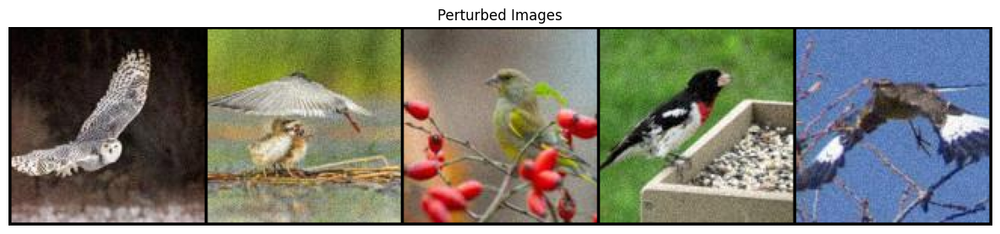

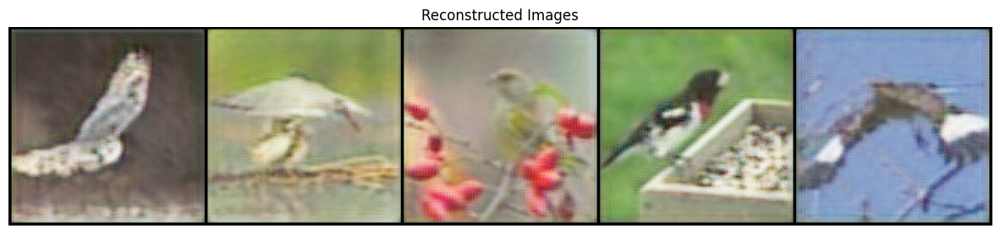

In [128]:
autoencoder = DenoisingConvAutoencoder()

early_stopping = EarlyStopping(
    monitor='val/loss',  # Metrius per monitorare
    patience=10,  # Numero di epoch senza miglioramenti dopo i quali fermare il training
    verbose=True,
    mode='min',  # 'min' per fermare quando la metrica smette di diminuire, 'max' per fermare quando smette di aumentare,
    min_delta=0.005
)

trainer = pl.Trainer(
    max_epochs=50,
    callbacks=[early_stopping]
)

trainer.fit(autoencoder, train_dataloader, val_dataloader)

show_images(autoencoder,size)

## Experiment 11

In [168]:
class DenoisingConvAutoencoder(pl.LightningModule):
    def __init__(self):
        super(DenoisingConvAutoencoder, self).__init__()
        self.validation_results = {
            'inputs': [],
            'perturbed': [],
            'outputs': []
        }
        self.train_step_losses = []
        self.val_step_losses = []
        self.train_losses = []
        self.val_losses = []

        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 16, kernel_size=7, stride=1, padding=3),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 32, kernel_size=5, stride=1, padding=2),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 64x64
            nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
        )

        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.Conv2d(32, 16, kernel_size=5, stride=1, padding=3),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 3, kernel_size=7, stride=1, padding=2),
            nn.Tanh()
        )

        self.criterion = nn.MSELoss()

    def forward(self, x):
        code = self.encoder(x)
        reconstructed = self.decoder(code)
        return code, reconstructed

    def configure_optimizers(self):
        optimizer = AdamW(self.parameters(), lr=1e-4, weight_decay=1e-3)
        return optimizer

    def training_step(self, train_batch, batch_idx):
        x_noisy, x_clean = train_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('train/loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.train_step_losses.append(loss.item())
        return loss

    def on_train_epoch_end(self):
        self.train_losses.append(self.train_step_losses[-1])

    def validation_step(self, val_batch, batch_idx):
        x_noisy, x_clean = val_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('val/loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.val_step_losses.append(loss.item())

        self.validation_results['inputs'] = x_clean
        self.validation_results['perturbed'] = x_noisy
        self.validation_results['outputs'] = reconstructed

        return loss

    def on_train_end(self):
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_losses, label='Training Loss')
        plt.plot(self.val_losses[1:], label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Training and Validation Loss')
        plt.legend()
        plt.show()

        torch.save(self.state_dict(), 'models/denoising_conv_autoencoder_v11.pth')

    def on_validation_epoch_end(self):
        self.val_losses.append(min(self.val_step_losses))
        
    def on_train_start(self):
        print()
        # Assicurati che il modello sia sulla CPU per il summary
        if torch.cuda.is_available():
            self.cuda()
        summary(self, (3, 128, 128))

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type       | Params
-----------------------------------------
0 | encoder   | Sequential | 403 K 
1 | decoder   | Sequential | 402 K 
2 | criterion | MSELoss    | 0     
-----------------------------------------
806 K     Trainable params
0         Non-trainable params
806 K     Total params
3.227     Total estimated model params size (MB)


Training: |          | 0/? [00:00<?, ?it/s]                                
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 16, 128, 128]           2,368
       BatchNorm2d-2         [-1, 16, 128, 128]              32
         LeakyReLU-3         [-1, 16, 128, 128]               0
            Conv2d-4         [-1, 32, 128, 128]          12,832
       BatchNorm2d-5         [-1, 32, 128, 128]              64
         LeakyReLU-6         [-1, 32, 128, 128]               0
            Conv2d-7         [-1, 64, 128, 128]          18,496
       BatchNorm2d-8         [-1, 64, 128, 128]             128
         LeakyReLU-9         [-1, 64, 128, 128]               0
           Conv2d-10        [-1, 128, 128, 128]          73,856
      BatchNorm2d-11        [-1, 128, 128, 128]             256
        LeakyReLU-12        [-1, 128, 128, 128]               0
        MaxPool2d-13       

Metric val/loss improved. New best score: 0.205


Epoch 1: 100%|██████████| 13/13 [03:35<00:00,  0.06it/s, v_num=49, train/loss_step=0.0289, val/loss_step=0.0456, val/loss_epoch=0.0702, train/loss_epoch=0.0246]

Metric val/loss improved by 0.134 >= min_delta = 0.005. New best score: 0.070


Epoch 2: 100%|██████████| 13/13 [03:39<00:00,  0.06it/s, v_num=49, train/loss_step=0.0134, val/loss_step=0.0235, val/loss_epoch=0.0236, train/loss_epoch=0.0199]

Metric val/loss improved by 0.047 >= min_delta = 0.005. New best score: 0.024


Epoch 3: 100%|██████████| 13/13 [03:40<00:00,  0.06it/s, v_num=49, train/loss_step=0.00892, val/loss_step=0.0189, val/loss_epoch=0.0175, train/loss_epoch=0.0178]

Metric val/loss improved by 0.006 >= min_delta = 0.005. New best score: 0.018


Epoch 13: 100%|██████████| 13/13 [03:29<00:00,  0.06it/s, v_num=49, train/loss_step=0.0136, val/loss_step=0.016, val/loss_epoch=0.0143, train/loss_epoch=0.014]  

Monitored metric val/loss did not improve in the last 10 records. Best score: 0.018. Signaling Trainer to stop.


Epoch 13: 100%|██████████| 13/13 [03:29<00:00,  0.06it/s, v_num=49, train/loss_step=0.0136, val/loss_step=0.016, val/loss_epoch=0.0143, train/loss_epoch=0.014]


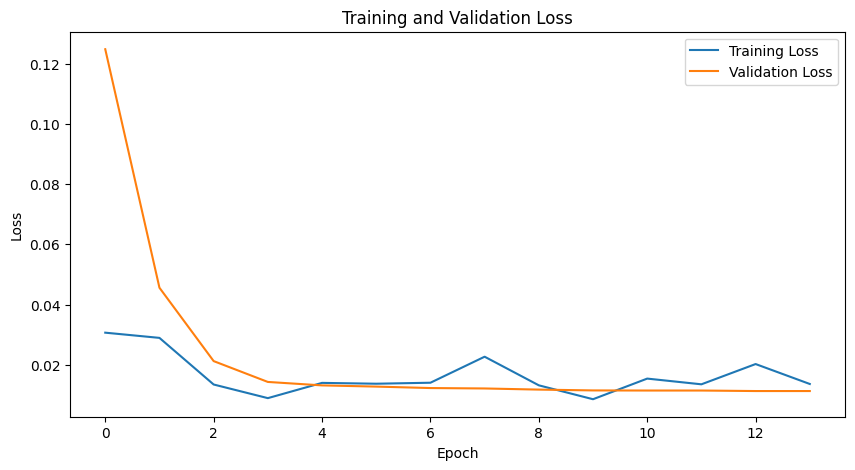

Average PSNR between clear and perturbed images: 30.73 dB
Average PSNR between clear and reconstructed images: 16.88 dB
Average SSIM between clear and perturbed images: 0.7557
Average SSIM between clear and reconstructed images: 0.4857


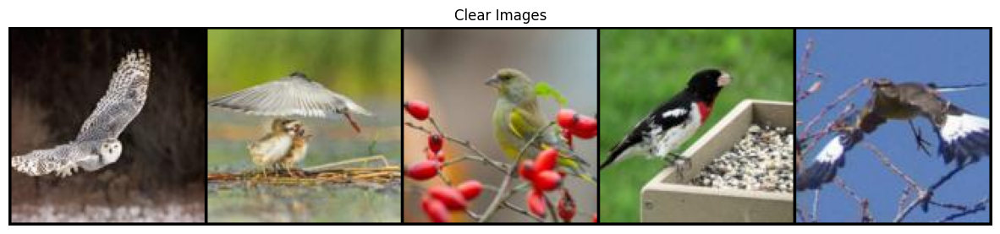

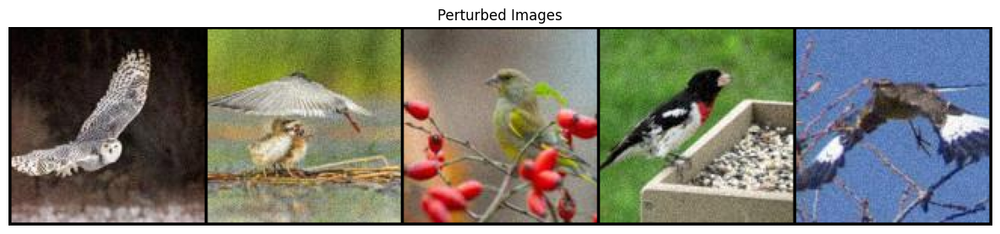

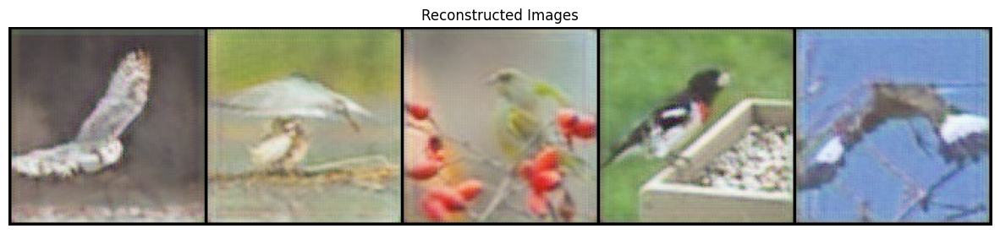

In [131]:
autoencoder = DenoisingConvAutoencoder()

early_stopping = EarlyStopping(
    monitor='val/loss',  # Metrius per monitorare
    patience=10,  # Numero di epoch senza miglioramenti dopo i quali fermare il training
    verbose=True,
    mode='min',  # 'min' per fermare quando la metrica smette di diminuire, 'max' per fermare quando smette di aumentare,
    min_delta=0.005
)

trainer = pl.Trainer(
    max_epochs=50,
    callbacks=[early_stopping]
)

trainer.fit(autoencoder, train_dataloader, val_dataloader)

show_images(autoencoder,size)

# Demo

In [298]:
class DenoisingConvAutoencoder(pl.LightningModule):
    def __init__(self):
        super(DenoisingConvAutoencoder, self).__init__()
        self.validation_results = {
            'inputs': [],
            'perturbed': [],
            'outputs': []
        }
        self.train_step_losses = []
        self.val_step_losses = []
        self.train_losses = []
        self.val_losses = []

        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 16, kernel_size=7, stride=1, padding=3),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 32, kernel_size=5, stride=1, padding=2),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.MaxPool2d(2, 2),  # 64x64
            nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
        )

        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2),
            nn.Conv2d(32, 16, kernel_size=5, stride=1, padding=3),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2),
            nn.Conv2d(16, 3, kernel_size=7, stride=1, padding=2),
            nn.Tanh()
        )

        self.criterion = nn.MSELoss()

    def forward(self, x):
        code = self.encoder(x)
        reconstructed = self.decoder(code)
        return code, reconstructed

    def configure_optimizers(self):
        optimizer = AdamW(self.parameters(), lr=1e-4, weight_decay=1e-3)
        return optimizer

    def training_step(self, train_batch, batch_idx):
        x_noisy, x_clean = train_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('train/loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.train_step_losses.append(loss.item())
        return loss

    def on_train_epoch_end(self):
        self.train_losses.append(self.train_step_losses[-1])

    def validation_step(self, val_batch, batch_idx):
        x_noisy, x_clean = val_batch
        _, reconstructed = self.forward(x_noisy)
        loss = self.criterion(x_clean, reconstructed)
        self.log('val/loss', loss, on_step=True, on_epoch=True, prog_bar=True, logger=True)
        self.val_step_losses.append(loss.item())

        self.validation_results['inputs'] = x_clean
        self.validation_results['perturbed'] = x_noisy
        self.validation_results['outputs'] = reconstructed

        return loss

    def on_train_end(self):
        plt.figure(figsize=(10, 5))
        plt.plot(self.train_losses, label='Training Loss')
        plt.plot(self.val_losses[1:], label='Validation Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.title('Training and Validation Loss')
        plt.legend()
        plt.show()

        torch.save(self.state_dict(), 'models/denoising_conv_autoencoder_v11.pth')

    def on_validation_epoch_end(self):
        self.val_losses.append(min(self.val_step_losses))
        
    def on_train_start(self):
        print()
        # Assicurati che il modello sia sulla CPU per il summary
        if torch.cuda.is_available():
            self.cuda()
        summary(self, (3, 128, 128))

## Model state loading

In [299]:
model_path = 'models/denoising_conv_autoencoder_v11.pth'
model = DenoisingConvAutoencoder()
model.load_state_dict(torch.load(model_path, map_location=torch.device('cpu')))
model.eval()

DenoisingConvAutoencoder(
  (encoder): Sequential(
    (0): Conv2d(3, 16, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3))
    (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2)
    (3): Conv2d(16, 32, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2)
    (6): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2)
    (9): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=0.2)
    (12): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (13): Conv2d(128, 256, kernel_size=(3, 3), st

## Funzione di pipeline per rimuovere il rumore data un'immagine

In [300]:
def remove_noise(noisy_image, model):

    # Define the transforms
    transform = transforms.Compose([
        transforms.Resize((128, 128)),
        transforms.ToTensor()
    ])

    input = transform(noisy_image).unsqueeze(0)

    # Get the model output
    with torch.no_grad():
        _, output = model(input)
        
    # Rimuovi la dimensione del batch dall'output
    output = output.squeeze(0)

    # Converti il tensore in immagine PIL
    output_img = transforms.ToPILImage()(output)
            
    return output_img

## Caricamento immagini dalla cartella demo e successivo resizing ed aggiunta del rumore

In [301]:
def load_and_resize_image(image_path, size=(128, 128)):
    image = Image.open(image_path)
    image_resized = image.resize(size)
    return np.array(image_resized)

In [302]:
from skimage.transform import resize


x = load_and_resize_image('demo/1.jpg')
y = load_and_resize_image('demo/2.jpg')

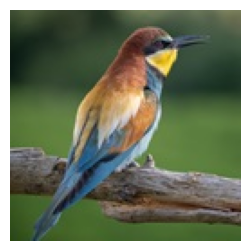

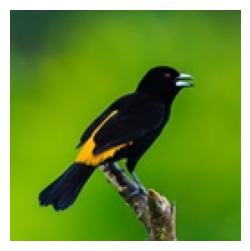

In [303]:
show_image(x)

show_image(y)

In [304]:
x_noisy = add_chromatic_noise(x, noise_level=0.03)
y_noisy = add_luminance_noise(y, noise_level=0.03)

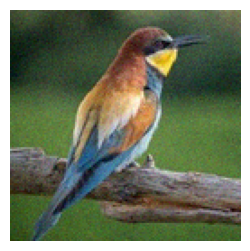

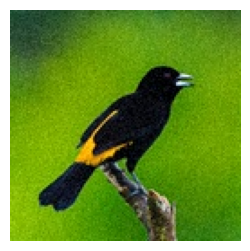

In [305]:
show_image(x_noisy)

show_image(y_noisy)

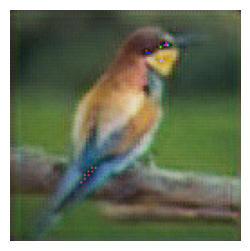

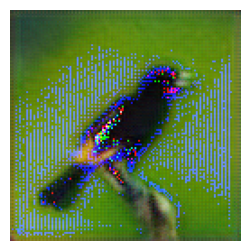

In [306]:
show_image(remove_noise(x_noisy, model))

show_image(remove_noise(y_noisy, model))